# Validated numerics with Julia

### Root finding, optimization, and constraints: guaranteed results


## David P. Sanders


### Department of Physics, Faculty of Sciences 
### Universidad Nacional Autónoma de México (UNAM)

#### 18.337, 31 October 2018

# JuliaIntervals: https://github.com/JuliaIntervals

- Interval analysis **tools** for set computation


- **Principal authors**: Luis Benet, David P. Sanders



- Used in other packages: 
    - EAGO - global optimization

    - JuliaReach - reachability analysis for dynamical systems
    




<tr>
    <td> <img  src="tori.png"  width="512">

<td> <img  src="stationary.png"  width="512"> &nbsp;
</tr>

<tr>
<td> <img src="lorenz.png"  width="512">
<td> <img src="tupper2.png"  width="400"> &nbsp;

</tr>

## Outline


- Root finding and optimization problems

- Modelling sets: Intervals

- How to handle constraints

- Algorithms


In [7]:
using ValidatedNumerics   # pulls in all packages

┌ Info: Precompiling ValidatedNumerics [d621b6e3-7715-5857-9c6f-c67000ef6083]
└ @ Base loading.jl:1189


# Solving difficult root-finding and optimization problems

## Solution set / feasible set:

- $\sin(y \cdot \exp(x) - 1) \le 0.5$

In [1]:
using Plots

using IntervalConstraintProgramming, IntervalArithmetic, IntervalRootFinding, Interact

┌ Info: Recompiling stale cache file /Users/dpsanders/.julia/compiled/v1.0/IntervalConstraintProgramming/DCiIm.ji for IntervalConstraintProgramming [138f1668-1576-5ad7-91b9-7425abbf3153]
└ @ Base loading.jl:1187


HTML{String}("    <script class='js-collapse-script'>\n        var curMatch =\n            window.location.href\n            .match(/(.*?)\\/notebooks\\/.*\\.ipynb/);\n\n        curMatch = curMatch ||\n            window.location.href\n            .match(/(.*?)\\/apps\\/.*\\.ipynb/);\n\n        if ( curMatch ) {\n            \$('head').append('<base href=\"' + curMatch[1] + '/\">');\n        }\n    </script>\n")

HTML{String}("<script class='js-collapse-script' src='/assetserver/bb5bb7523f347acc41c08d69d8cd0a3c4760eb4b-assets/webio/dist/bundle.js'></script>")

HTML{String}("<script class='js-collapse-script' src='/assetserver/bb5bb7523f347acc41c08d69d8cd0a3c4760eb4b-assets/providers/ijulia_setup.js'></script>")

HTML{String}("  <script class='js-collapse-script'>\n    \$('.js-collapse-script').parent('.output_subarea').css('padding', '0');\n  </script>\n")

In [4]:
@manipulate for a in 0.0:0.1:1.0
    
    C = @constraint sin(y * exp(x) - 1) - $a <= 0.0

    X = (-5..5) × (-5..5)  # box

    @time paving = pave(C, X, 0.1)

    plot(paving.inner, lw=1, label=""); plot!(paving.boundary, lw=0, label="")
end

  0.426674 seconds (750.70 k allocations: 78.423 MiB, 30.60% gc time)


Widget{:manipulate,Any}(OrderedDict{Symbol,Any}(:a=>Widget{:slider,Float64}(OrderedDict{Symbol,Any}(:changes=>Observable{Int64}("ob_21", 0, Any[SyncCallback(Scope("knockout-component-d95017c9-f867-4198-b935-a9af84fedf31", Node{DOM}(DOM(:html, :div), Any[Node{DOM}(DOM(:html, :div), Any[Node{DOM}(DOM(:html, :label), Any["a"], Dict{Symbol,Any}(:className=>"interact ",:style=>Dict{Any,Any}(:padding=>"5px 10px 0px 10px")), 1)], Dict{Symbol,Any}(:attributes=>Dict("style"=>"text-align:right;width:18%")), 2), Node{DOM}(DOM(:html, :div), Any[Node{DOM}(DOM(:html, :input), Any[], Dict{Symbol,Any}(:max=>11,:min=>1,:attributes=>Dict{Any,Any}(:type=>"range",Symbol("data-bind")=>"numericValue: index, valueUpdate: 'input', event: {change : function () {this.changes(this.changes()+1)}}","orient"=>"horizontal"),:step=>1,:className=>"slider slider is-fullwidth",:style=>Dict{Any,Any}()), 0)], Dict{Symbol,Any}(:attributes=>Dict("style"=>"flex-grow:1; margin: 0 2%")), 1), Node{DOM}(DOM(:html, :div), Any[Node{DOM}(DOM(:html, :p), Any[], Dict{Symbol,Any}(:attributes=>Dict("data-bind"=>"text: formatted_value")), 0)], Dict{Symbol,Any}(:attributes=>Dict("style"=>"width:18%")), 1)], Dict{Symbol,Any}(:attributes=>Dict("style"=>"display:flex; justify-content:center; align-items:center;")), 7), Dict{String,Tuple{Observables.AbstractObservable,Union{Nothing, Bool}}}("formatted_vals"=>(Observable{Any}("ob_19", ["0.0", "0.1", "0.2", "0.3", "0.4", "0.5", "0.6", "0.7", "0.8", "0.9", "1.0"], Any[SyncCallback(Scope(#= circular reference @-6 =#), SyncCallback(Scope(#= circular reference @-7 =#), ##40#42{Scope,String}(Scope(#= circular reference @-8 =#), "formatted_vals")))]), nothing),"changes"=>(Observable{Int64}(#= circular reference @-6 =#), nothing),"formatted_value"=>(Observable{String}("ob_20", "0.5", Any[SyncCallback(Scope(#= circular reference @-6 =#), SyncCallback(Scope(#= circular reference @-7 =#), ##40#42{Scope,String}(Scope(#= circular reference @-8 =#), "formatted_value")))]), nothing),"index"=>(Observable{Any}("ob_18", 6, Any[##25#28{##70#73,Observable{Float64},Array{Function,1}}(##70#73(Box(0.0:0.1:1.0)), Observable{Float64}("ob_17", 0.5, Any[##24#27{##68#71,Observable{Any},Array{Function,1}}(##68#71(Box(0.0:0.1:1.0)), Observable{Any}(#= circular reference @-6 =#), Function[##24#27{##68#71,Observable{Any},Array{Function,1}}(#= circular reference @-2 =#), ##25#28{##70#73,Observable{Float64},Array{Function,1}}(#= circular reference @-5 =#)]), #g#15{##16#17{##19#23,Observable{Any}},Tuple{Observable{Float64}}}(##16#17{##19#23,Observable{Any}}(##19#23(), Observable{Any}("ob_22", Plot{Plots.GRBackend() n=2}, Any[])), (Observable{Float64}(#= circular reference @-4 =#),))]), Function[##24#27{##68#71,Observable{Any},Array{Function,1}}(##68#71(Box(0.0:0.1:1.0)), Observable{Any}(#= circular reference @-5 =#), Function[#= circular reference @-2 =#]), ##25#28{##70#73,Observable{Float64},Array{Function,1}}(#= circular reference @-2 =#)]), SyncCallback(Scope(#= circular reference @-6 =#), SyncCallback(Scope(#= circular reference @-7 =#), ##40#42{Scope,String}(Scope(#= circular reference @-8 =#), "index")))]), nothing)), Set(String[]), nothing, Any["knockout"=>"/Users/dpsanders/.julia/packages/Knockout/JIqpG/src/../assets/knockout.js", "knockout_punches"=>"/Users/dpsanders/.julia/packages/Knockout/JIqpG/src/../assets/knockout_punches.js", "/Users/dpsanders/.julia/packages/InteractBase/Q4IkI/src/../assets/all.js", "/Users/dpsanders/.julia/packages/InteractBase/Q4IkI/src/../assets/style.css", "/Users/dpsanders/.julia/packages/InteractBulma/Ohu5Y/src/../assets/main.css"], Dict{Any,Any}("formatted_vals"=>Any[JSString("(function (val){return (val!=this.model[\"formatted_vals\"]()) ? (this.valueFromJulia[\"formatted_vals\"]=true, this.model[\"formatted_vals\"](val)) : undefined})")],"_promises"=>Dict{Any,Any}("importsLoaded"=>Any[JSString("function (ko, koPunches) {\n    ko.punches.enableAll();\n    ko.bindingHandlers.numericValue = {\n        init : function(element, va

  0.241669 seconds (594.90 k allocations: 71.331 MiB, 7.93% gc time)


- Tupper 1996:

$$(y − 5) \cos \left[4 \sqrt{(x-4)^2 + y^2} \right] > x \sin \left[2 \sqrt{x^2 + y^2} \right]$$

In [5]:
C = @constraint (y-5)*cos(4*sqrt((x-4)^2+y^2)) - x*sin(2*sqrt(x^2 + y^2)) >= 0

X = IntervalBox(-5..5, 2)
@time paving = pave(C, X, 0.05)

plot(paving.inner, lw=0, aspect_ratio=1, leg=false)
plot!(paving.boundary, lw=0)

  1.270744 seconds (4.20 M allocations: 230.498 MiB, 7.51% gc time)


## Roots

- Example from `NLSolve.jl` README:

\begin{align}
    (x+3)(y^3-7)+18 &= 0 \\
    \sin[y \, \exp(x)−1] &= 0
    \end{align}
    
- How many roots are there?

In [6]:
using Makie

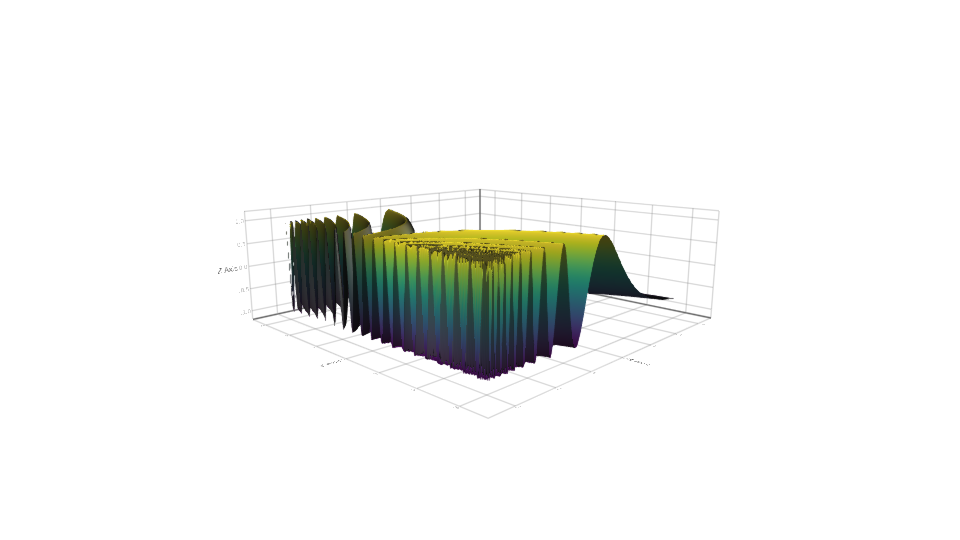

In [7]:
#plotlyjs()

f1(x, y) = sin(y*exp(x) - 1)
r = -3:0.01:3
Makie.surface(r, r, f1)
#surface!(r, r, (x,y)->0.0, alpha=0.5, cbar=false)
#zlims!(-1, 1)

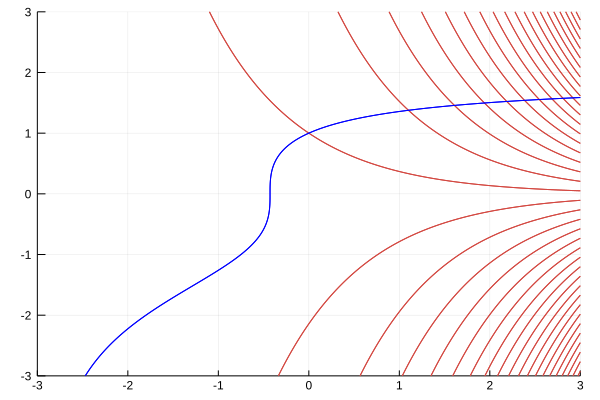

In [8]:
gr()
Plots.contour(r, r, (x,y)->sin(y*exp(x)-1), levels=[0.0, 0.001], cbar=false)
Plots.contour!(r, r, (x,y)->(x + 3) * (y^3 - 7) + 18, levels=[0.0, 0.001], cbar=false, color = cgrad([:blue, :blue]))

## *Guaranteed* version:

In [74]:
using IntervalConstraintProgramming, Plots, IntervalArithmetic, Interact

In [76]:
@manipulate for a in 1:10
    C1 = @constraint (x + 3)*(y^3 - $a) + 18 == 0
    C2 = @constraint sin(y*exp(x) - 1) == 0

    X = IntervalBox(-5..5, 2)
    p1 = pave(C1, X, 0.1); @time p2 = pave(C2, X, 0.1)

    plot(p1.boundary, lw=0); plot!(p2.boundary, lw=0, leg=false)

    @time p3 = pave(C1 ∩ C2, X, 0.1); plot!(p3.boundary, lw=3, label="")
end

  0.634224 seconds (921.34 k allocations: 85.415 MiB, 38.97% gc time)
  0.118007 seconds (183.50 k allocations: 10.040 MiB)


Widget{:manipulate,Any}(OrderedDict{Symbol,Any}(:a=>Widget{:slider,Int64}(OrderedDict{Symbol,Any}(:changes=>Observable{Int64}("ob_33", 0, Any[SyncCallback(Scope("knockout-component-3828c312-651c-4986-83d6-8013a89476c7", Node{DOM}(DOM(:html, :div), Any[Node{DOM}(DOM(:html, :div), Any[Node{DOM}(DOM(:html, :label), Any["a"], Dict{Symbol,Any}(:className=>"interact ",:style=>Dict{Any,Any}(:padding=>"5px 10px 0px 10px")), 1)], Dict{Symbol,Any}(:attributes=>Dict("style"=>"text-align:right;width:18%")), 2), Node{DOM}(DOM(:html, :div), Any[Node{DOM}(DOM(:html, :input), Any[], Dict{Symbol,Any}(:max=>10,:min=>1,:attributes=>Dict{Any,Any}(:type=>"range",Symbol("data-bind")=>"numericValue: value, valueUpdate: 'input', event: {change : function () {this.changes(this.changes()+1)}}","orient"=>"horizontal"),:step=>1,:className=>"slider slider is-fullwidth",:style=>Dict{Any,Any}()), 0)], Dict{Symbol,Any}(:attributes=>Dict("style"=>"flex-grow:1; margin: 0 2%")), 1), Node{DOM}(DOM(:html, :div), Any[Node{DOM}(DOM(:html, :p), Any[], Dict{Symbol,Any}(:attributes=>Dict("data-bind"=>"text: value")), 0)], Dict{Symbol,Any}(:attributes=>Dict("style"=>"width:18%")), 1)], Dict{Symbol,Any}(:attributes=>Dict("style"=>"display:flex; justify-content:center; align-items:center;")), 7), Dict{String,Tuple{Observables.AbstractObservable,Union{Nothing, Bool}}}("changes"=>(Observable{Int64}(#= circular reference @-6 =#), nothing),"value"=>(Observable{Int64}("ob_32", 5, Any[SyncCallback(Scope(#= circular reference @-6 =#), SyncCallback(Scope(#= circular reference @-7 =#), ##40#42{Scope,String}(Scope(#= circular reference @-8 =#), "value"))), #g#15{##16#17{##85#91,Observable{Any}},Tuple{Observable{Int64}}}(##16#17{##85#91,Observable{Any}}(##85#91(), Observable{Any}("ob_34", Plot{Plots.GRBackend() n=3}, Any[])), (Observable{Int64}(#= circular reference @-4 =#),))]), nothing)), Set(String[]), nothing, Any["knockout"=>"/Users/dpsanders/.julia/packages/Knockout/JIqpG/src/../assets/knockout.js", "knockout_punches"=>"/Users/dpsanders/.julia/packages/Knockout/JIqpG/src/../assets/knockout_punches.js", "/Users/dpsanders/.julia/packages/InteractBase/Q4IkI/src/../assets/all.js", "/Users/dpsanders/.julia/packages/InteractBase/Q4IkI/src/../assets/style.css", "/Users/dpsanders/.julia/packages/InteractBulma/Ohu5Y/src/../assets/main.css"], Dict{Any,Any}("_promises"=>Dict{Any,Any}("importsLoaded"=>Any[JSString("function (ko, koPunches) {\n    ko.punches.enableAll();\n    ko.bindingHandlers.numericValue = {\n        init : function(element, valueAccessor, allBindings, data, context) {\n            var stringified = ko.observable(ko.unwrap(valueAccessor()));\n            stringified.subscribe(function(value) {\n                var val = parseFloat(value);\n                if (!isNaN(val)) {\n                    valueAccessor()(val);\n                }\n            })\n            valueAccessor().subscribe(function(value) {\n                var str = JSON.stringify(value);\n                if ((str == \"0\") && ([\"-0\", \"-0.\"].indexOf(stringified()) >= 0))\n                     return;\n                 if ([\"null\", \"\"].indexOf(str) >= 0)\n                     return;\n                stringified(str);\n            })\n            ko.applyBindingsToNode(element, { value: stringified, valueUpdate: allBindings.get('valueUpdate')}, context);\n        }\n    };\n    var json_data = JSON.parse(\"{\\\"changes\\\":0,\\\"value\\\":5}\");\n    var self = this;\n    function AppViewModel() {\n        for (var key in json_data) {\n            var el = json_data[key];\n            this[key] = Array.isArray(el) ? ko.observableArray(el) : ko.observable(el);\n        }\n        \n        \n        [this[\"changes\"].subscribe((function (val){!(this.valueFromJulia[\"changes\"]) ? (WebIO.setval({\"name\":\"changes\",\"scope\":\"knockout-component-3828c312-651c-4986-83d6-8013a89476c7\",\"id\":\"ob_33\",\"type\":\"observable\"},val)) : undefined; return this.valueFromJulia[\"changes\"]=false}),self

  0.346850 seconds (781.85 k allocations: 78.605 MiB, 10.54% gc time)
  0.065865 seconds (188.64 k allocations: 8.952 MiB)
  0.338971 seconds (781.85 k allocations: 78.605 MiB, 9.66% gc time)
  0.004396 seconds (13.93 k allocations: 1.024 MiB)


In [80]:
using IntervalRootFinding, StaticArrays

X = IntervalBox(-5..5, 2)

f(x, y) = SVector( (x + 3) * (y^3 - 7) + 18, 
                  sin(y * exp(x) - 1) ) 
f(xx) = f(xx[1], xx[2])

@time rts = roots(f, X, Newton, 1e-20)

display(rts[1:5]); display(length(rts))
all(isunique, rts)

5-element Array{Root{IntervalBox{2,Float64}},1}:
 Root([4.99884, 4.99885] × [1.68094, 1.68095], :unique)
 Root([4.98639, 4.9864] × [1.68053, 1.68054], :unique) 
 Root([4.97379, 4.9738] × [1.68011, 1.68012], :unique) 
 Root([4.96103, 4.96104] × [1.67968, 1.67969], :unique)
 Root([4.9481, 4.94811] × [1.67925, 1.67926], :unique) 

80

  0.212698 seconds (590.07 k allocations: 24.607 MiB, 7.45% gc time)


true

In [83]:
gr()

r = -1:0.01:5
Plots.contour(r, r, (x,y)->sin(y*exp(x)-1), levels=[0.0, 0.001], cbar=false)
Plots.contour!(r, r, (x,y)->(x + 3) * (y^3 - 7) + 18, levels=[0.0, 0.001], cbar=false, color = cgrad([:blue, :blue]))

mids = mid.(interval.(rts))

Plots.scatter!(first.(mids), last.(mids), ms=1, aspect_ratio=1)

## Stationary points

In [9]:
G(X) = 1 + sum(X.^2) / 4000 - prod( cos(X[i] / √i) for i in 1:length(X) )

G (generic function with 1 method)

In [12]:
using IntervalRootFinding

@time rts = roots(∇(G), IntervalBox(-10..10, 2))

  0.019121 seconds (23.61 k allocations: 2.094 MiB, 63.93% gc time)


59-element Array{Root{IntervalBox{2,Float64}},1}:
 Root([9.42949, 9.4295] × [8.89466, 8.89467], :unique)          
 Root([7.84927, 7.84928] × [6.65877, 6.65878], :unique)         
 Root([6.28004, 6.28005] × [8.87688, 8.87689], :unique)         
 Root([9.42006, 9.42007] × [4.43844, 4.43845], :unique)         
 Root([9.42949, 9.4295] × [4.94065e-324, 4.94066e-324], :unique)
 Root([7.85555, 7.85556] × [2.22699, 2.227], :unique)           
 Root([6.28632, 6.28633] × [4.44733, 4.44734], :unique)         
 Root([6.28004, 6.28005] × [-3.77259e-19, 6.05846e-27], :unique)
 Root([3.14316, 3.14317] × [8.89466, 8.89467], :unique)         
 Root([0, 0] × [8.87688, 8.87689], :unique)                     
 Root([4.7171, 4.71711] × [6.66765, 6.66766], :unique)          
 Root([1.56608, 1.56609] × [6.66321, 6.66322], :unique)         
 Root([3.14002, 3.14003] × [4.43844, 4.43845], :unique)         
 ⋮                                                              
 Root([-1.57237, -1.57236] × [-2.22256, 

In [13]:
using IntervalArithmetic, StaticArrays, IntervalRootFinding
using Makie   # new Julia 2D and 3D plotting package

G(x, y) = G([x, y])

mids = mid.(interval.(rts))
vals = G.(mids)

59-element Array{Float64,1}:
 2.041976686837409   
 1.026506069456991   
 0.02958416121206986 
 0.027125384395415675
 2.0222177187824206  
 1.016661134278616   
 2.0148142836469805  
 0.009864672061006274
 2.0222276032778113  
 0.019719489248184896
 1.0166660691163318  
 1.0117164599688457  
 0.007396040334115117
 ⋮                   
 1.001851785452283   
 1.0067816553099953  
 0.007396040334115117
 1.0117164599688457  
 1.0166660691163318  
 2.0222276032778113  
 1.016661134278616   
 2.0148142836469805  
 0.027125384395415675
 0.02958416121206986 
 1.026506069456991   
 2.041976686837409   

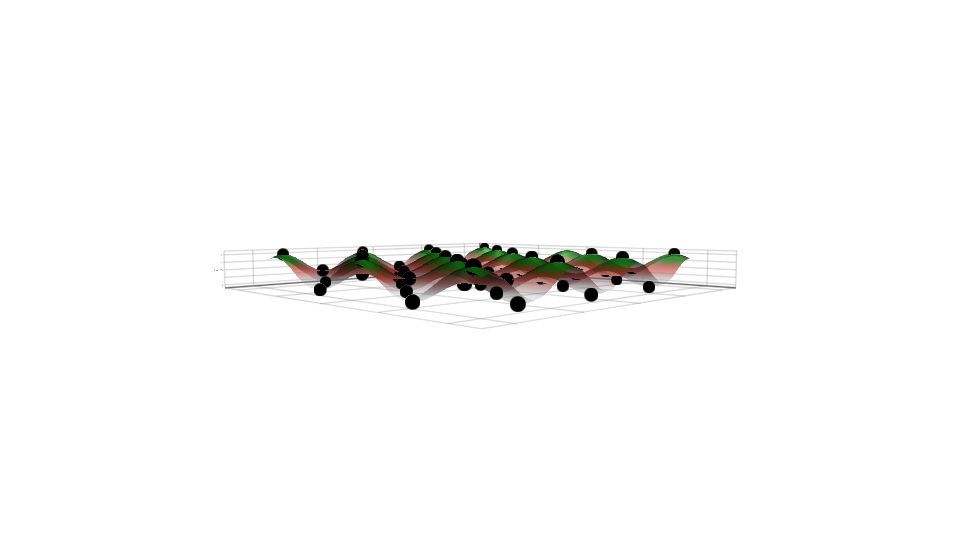

In [15]:
N = 10; r = -N:0.1:N

Makie.surface(
    r, r, G,
    colormap = [(:black, 0.1), (:red, 0.5), (:green, 0.8)]
)

Makie.scatter!(first.(mids), last.(mids), G.(mids), markersize=0.8)

In [21]:
using Plots, IntervalConstraintProgramming, IntervalRootFinding, IntervalArithmetic

In [20]:
using ForwardDiff, LinearAlgebra

stability(f, X) = count(eigvals(ForwardDiff.hessian(f, X)) .> 0)  # can make rigorous

mids = mid.(interval.(rts))
stabilities = stability.(G, mids)
mins = mids[stabilities .== 2]; maxs = mids[stabilities .== 0]; stats = mids[stabilities .== 1]

ErrorException: Only hermitian matrices are diagonalizable by *StaticArrays*. Non-Hermitian matrices should be converted to `Array` first.

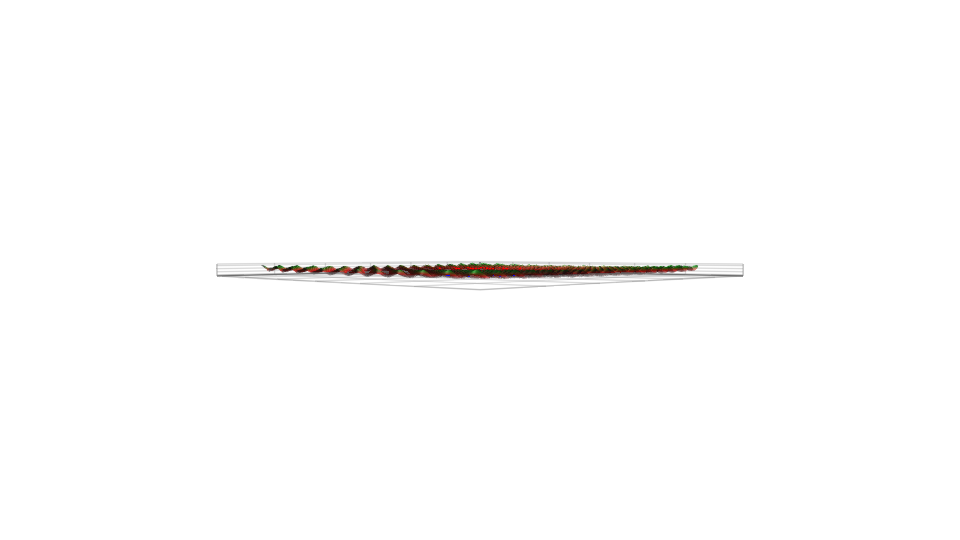

In [95]:
N = 50; r = -N:0.1:N

Makie.surface(
    r, r, G,
    colormap = [(:black, 0.1), (:red, 0.5), (:green, 0.8)],
)

Makie.scatter!(first.(mins), last.(mins), G.(mins), markersize=0.8, color=:blue)
Makie.scatter!(first.(maxs), last.(maxs), G.(maxs), markersize=0.8, color=:red)
Makie.scatter!(first.(stats), last.(stats), G.(stats), markersize=0.8, color=:green)

## Fixed points of Lorenz system

$$
\begin{align}
\dot{x} &= \sigma (y-x) \\
\dot{y} &= x(\rho -z)-y \\
\dot{z} &= xy-\beta z
\end{align}
$$

In [1]:
using Plots

In [2]:
using StaticArrays, DifferentialEquations, IntervalRootFinding
plotlyjs()

HTML{String}("    <script class='js-collapse-script'>\n        var curMatch =\n            window.location.href\n            .match(/(.*?)\\/notebooks\\/.*\\.ipynb/);\n\n        curMatch = curMatch ||\n            window.location.href\n            .match(/(.*?)\\/apps\\/.*\\.ipynb/);\n\n        if ( curMatch ) {\n            \$('head').append('<base href=\"' + curMatch[1] + '/\">');\n        }\n    </script>\n")

HTML{String}("<script class='js-collapse-script' src='/assetserver/ce2f5c429491c3bfb0ab4337874a18483878aa36-assets/webio/dist/bundle.js'></script>")

HTML{String}("<script class='js-collapse-script' src='/assetserver/ce2f5c429491c3bfb0ab4337874a18483878aa36-assets/providers/ijulia_setup.js'></script>")

HTML{String}("  <script class='js-collapse-script'>\n    \$('.js-collapse-script').parent('.output_subarea').css('padding', '0');\n  </script>\n")

INFO: Loading HttpServer methods...


Plots.PlotlyJSBackend()

In [96]:
function parameterized_lorenz(du, u, p, t)
    du[1] = p[1] * (u[2] - u[1])
    du[2] = u[1] * (p[2] - u[3]) - u[2]
    du[3] = u[1] * u[2] - p[3] * u[3]
end

lorenz2(u, p) = SVector(
    p[1]*(u[2]-u[1]),
    u[1]*(p[2]-u[3]) - u[2],
    u[1]*u[2] - p[3]*u[3]
    )

lorenz2 (generic function with 1 method)

In [100]:
function draw_lorenz(ρ, T)
    p = [10.0, ρ, 8/3]
    J = ForwardDiff.jacobian(u->lorenz2(u, p), SVector(0, 0, 0))
    λs, vs = eig(Array(J))

    which = indmax(λs)  # unstable is biggest
    unstab_direction = vs[:, which]  
    
    u0 = 1e-5 * unstab_direction
    tspan = (0.0, T)

    prob = ODEProblem(parameterized_lorenz, u0, tspan, p)

    sol = solve(prob)

    plot(sol, vars=(1, 2, 3), c=:blue, alpha=0.8, lw=1)
    
    
    u0 = -1e-5 * unstab_direction
    tspan = (0.0, T)

    prob = ODEProblem(parameterized_lorenz, u0, tspan, p)

    sol = solve(prob)

    plot!(sol, vars=(1, 2, 3), c=:red, alpha=0.8, lw=1)
    
   
    X = IntervalBox(-50..51, 3)
    rts = roots(u->lorenz2(u, p), X)
    mids = mid.([rt.interval for rt in rts])
    
    scatter!(getindex.(mids, 1), getindex.(mids, 2), getindex.(mids, 3), alpha=1.0, ms=5)

    xlims!(-30, 30)
    ylims!(-30, 30)
    zlims!(-1, 50)
end

draw_lorenz (generic function with 1 method)

In [101]:
using Interact, IntervalArithmetic

In [24]:
# plotlyjs()

# @manipulate throttle=0.5 for ρ in slider(0:0.1:100, value=28.0), T in 1:0.1:100
    
#     draw_lorenz(ρ, T)
# end


## *Global* optimisation

Griewank function $G: \mathbb{R}^n \to \mathbb{R}$:

$$G(\mathbf{x}) = 1 + \frac{1}{4000} \sum_{i=1}^n x_i^2 - \prod_{i=1}^n \cos \left( \frac{x_i}{\sqrt i} \right)$$

In [23]:
using IntervalOptimisation, IntervalArithmetic

In [24]:
@manipulate for n in Interact.slider(1:100, value=1)
    @time global_min, minimizers = minimise(G, IntervalBox(-600..600, n))
    global_min, minimizers
end

  0.699240 seconds (1.72 M allocations: 85.156 MiB, 8.70% gc time)


Widget{:manipulate,Any}(OrderedDict{Symbol,Any}(:n=>Widget{:slider,Int64}(OrderedDict{Symbol,Any}(:changes=>Observable{Int64}("ob_28", 0, Any[SyncCallback(Scope("knockout-component-21ee015e-6e58-4118-86ef-6ca2029960a9", Node{DOM}(DOM(:html, :div), Any[Node{DOM}(DOM(:html, :div), Any[Node{DOM}(DOM(:html, :label), Any[nothing], Dict{Symbol,Any}(:className=>"interact ",:style=>Dict{Any,Any}(:padding=>"5px 10px 0px 10px")), 1)], Dict{Symbol,Any}(:attributes=>Dict("style"=>"text-align:right;width:18%")), 2), Node{DOM}(DOM(:html, :div), Any[Node{DOM}(DOM(:html, :input), Any[], Dict{Symbol,Any}(:max=>100,:min=>1,:attributes=>Dict{Any,Any}(:type=>"range",Symbol("data-bind")=>"numericValue: value, valueUpdate: 'input', event: {change : function () {this.changes(this.changes()+1)}}","orient"=>"horizontal"),:step=>1,:className=>"slider slider is-fullwidth",:style=>Dict{Any,Any}()), 0)], Dict{Symbol,Any}(:attributes=>Dict("style"=>"flex-grow:1; margin: 0 2%")), 1), Node{DOM}(DOM(:html, :div), Any[Node{DOM}(DOM(:html, :p), Any[], Dict{Symbol,Any}(:attributes=>Dict("data-bind"=>"text: value")), 0)], Dict{Symbol,Any}(:attributes=>Dict("style"=>"width:18%")), 1)], Dict{Symbol,Any}(:attributes=>Dict("style"=>"display:flex; justify-content:center; align-items:center;")), 7), Dict{String,Tuple{Observables.AbstractObservable,Union{Nothing, Bool}}}("changes"=>(Observable{Int64}(#= circular reference @-6 =#), nothing),"value"=>(Observable{Int64}("ob_27", 1, Any[SyncCallback(Scope(#= circular reference @-6 =#), SyncCallback(Scope(#= circular reference @-7 =#), ##40#42{Scope,String}(Scope(#= circular reference @-8 =#), "value"))), #g#15{##16#17{##41#43,Observable{Any}},Tuple{Observable{Int64}}}(##16#17{##41#43,Observable{Any}}(##41#43(), Observable{Any}("ob_29", ([0, 0], IntervalBox{1,Float64}[[-0.000373153, 0.000168253]]), Any[])), (Observable{Int64}(#= circular reference @-4 =#),))]), nothing)), Set(String[]), nothing, Any["knockout"=>"/Users/dpsanders/.julia/packages/Knockout/JIqpG/src/../assets/knockout.js", "knockout_punches"=>"/Users/dpsanders/.julia/packages/Knockout/JIqpG/src/../assets/knockout_punches.js", "/Users/dpsanders/.julia/packages/InteractBase/Q4IkI/src/../assets/all.js", "/Users/dpsanders/.julia/packages/InteractBase/Q4IkI/src/../assets/style.css", "/Users/dpsanders/.julia/packages/InteractBulma/Ohu5Y/src/../assets/main.css"], Dict{Any,Any}("_promises"=>Dict{Any,Any}("importsLoaded"=>Any[JSString("function (ko, koPunches) {\n    ko.punches.enableAll();\n    ko.bindingHandlers.numericValue = {\n        init : function(element, valueAccessor, allBindings, data, context) {\n            var stringified = ko.observable(ko.unwrap(valueAccessor()));\n            stringified.subscribe(function(value) {\n                var val = parseFloat(value);\n                if (!isNaN(val)) {\n                    valueAccessor()(val);\n                }\n            })\n            valueAccessor().subscribe(function(value) {\n                var str = JSON.stringify(value);\n                if ((str == \"0\") && ([\"-0\", \"-0.\"].indexOf(stringified()) >= 0))\n                     return;\n                 if ([\"null\", \"\"].indexOf(str) >= 0)\n                     return;\n                stringified(str);\n            })\n            ko.applyBindingsToNode(element, { value: stringified, valueUpdate: allBindings.get('valueUpdate')}, context);\n        }\n    };\n    var json_data = JSON.parse(\"{\\\"changes\\\":0,\\\"value\\\":1}\");\n    var self = this;\n    function AppViewModel() {\n        for (var key in json_data) {\n            var el = json_data[key];\n            this[key] = Array.isArray(el) ? ko.observableArray(el) : ko.observable(el);\n        }\n        \n        \n        [this[\"changes\"].subscribe((function (val){!(this.valueFromJulia[\"changes\"]) ? (WebIO.setval({\"name\":\"changes\",\"scope\":\"knockout-component-21ee015e-6e58-4118-86ef-6ca2029960a9\",\"id\":\"ob_28\",\"type\":\"observable\"},val)) : undefined; return this.v

  0.522429 seconds (1.35 M allocations: 66.069 MiB, 8.17% gc time)
  0.000083 seconds (214 allocations: 7.313 KiB)
  0.000166 seconds (390 allocations: 16.484 KiB)
  3.938784 seconds (4.85 M allocations: 215.586 MiB, 9.95% gc time)
  3.498049 seconds (4.78 M allocations: 212.100 MiB, 4.33% gc time)
  0.025755 seconds (11.23 k allocations: 4.966 MiB)
  0.026412 seconds (10.99 k allocations: 4.837 MiB)
  3.517464 seconds (6.57 M allocations: 273.496 MiB, 6.05% gc time)
  3.532326 seconds (6.32 M allocations: 263.416 MiB, 6.17% gc time)


## Unconstrained global optimization

In [28]:
using IntervalOptimisation, IntervalArithmetic

f(x, y) = (1.5 - x * (1 - y))^2 + (2.25 - x * (1 - y^2))^2 + (2.625 - x * (1 - y^3))^2
f(X) = f(X...)

#X = (-1e6..1e6) × (-1e6..1e6)
X = 

minimise_icp(f, X)

UndefVarError: UndefVarError: icp not defined

## Constrained global optimization

In [25]:
using IntervalArithmetic, IntervalOptimisation, Interact, Plots, IntervalConstraintProgramming

- Minimize $x + y$ such that $x^2 + y^2 <= 1$.

Interact.Options{:SelectionSlider,Float64}(65: "input-19" = 0.0 Float64 , "a", 0.0, "0.0", 201, Interact.OptionDict(DataStructures.OrderedDict("-2.0"=>-2.0,"-1.99"=>-1.99,"-1.98"=>-1.98,"-1.97"=>-1.97,"-1.96"=>-1.96,"-1.95"=>-1.95,"-1.94"=>-1.94,"-1.93"=>-1.93,"-1.92"=>-1.92,"-1.91"=>-1.91…), Dict(-0.92=>"-0.92",1.2=>"1.2",1.68=>"1.68",-0.22=>"-0.22",-1.78=>"-1.78",1.19=>"1.19",-1.23=>"-1.23",0.22=>"0.22",-1.16=>"-1.16",0.2=>"0.2"…)), Any[], Any[], true, "horizontal", true)

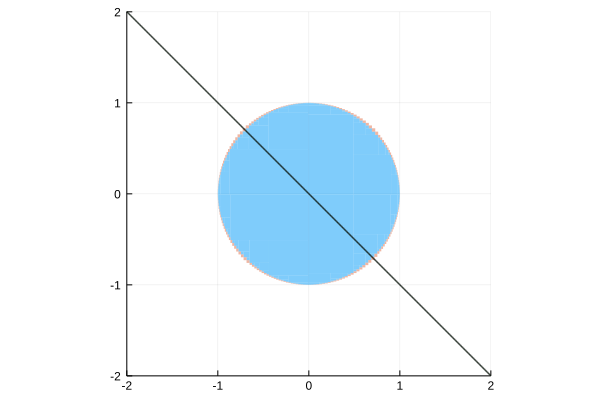

In [90]:
gr()
X = IntervalBox(-2..2, 2)
C = @constraint x^2 + y^2 <= 1
paving1 = pave(C, X, 0.05)

@manipulate for a in -2:0.01:2
    C2 = @constraint x + y - $a == 0
    paving2 = pave(C2, X, 0.01)
    
    plot(paving1.inner, lw=0, aspect_ratio=1, leg=false);   plot!(paving1.boundary, lw=0, aspect_ratio=1)
    plot!(paving2.boundary)
    
    xlims!(-2, 2); ylims!(-2, 2)
end

In [91]:
f(X) = (X[1] + X[2])

X = (-∞..∞) × (-∞..∞)

constraints = [IntervalOptimisation.Constraint(x->(x[1]^2 + x[2]^2), -∞..1)]

1-element Array{IntervalOptimisation.Constraint{Float64},1}:
 IntervalOptimisation.Constraint{Float64}(#144, [-∞, 1])

In [92]:
@time minimise_icp_constrained(f, X, constraints, abstol=1e-5) 

([-1.41423, -1.41421], IntervalArithmetic.IntervalBox{2,Float64}[[-0.70686, -0.706854] × [-0.707365, -0.707354], [-0.707106, -0.7071] × [-0.707118, -0.707108], [-0.706758, -0.706747] × [-0.707466, -0.707458], [-0.706874, -0.706863] × [-0.707351, -0.707342], [-0.70679, -0.706779] × [-0.707434, -0.707426], [-0.706768, -0.706762] × [-0.707456, -0.707446], [-0.707539, -0.707528] × [-0.706685, -0.706679], [-0.706941, -0.706935] × [-0.707283, -0.707272], [-0.706883, -0.706878] × [-0.707341, -0.70733], [-0.706899, -0.706894] × [-0.707325, -0.707314]  …  [-0.705181, -0.705178] × [-0.709032, -0.709028], [-0.708776, -0.708772] × [-0.705436, -0.705433], [-0.708795, -0.708791] × [-0.705417, -0.705414], [-0.705462, -0.70546] × [-0.70875, -0.708746], [-0.708955, -0.708952] × [-0.705257, -0.705255], [-0.709515, -0.709508] × [-0.704698, -0.704694], [-0.704803, -0.7048] × [-0.709409, -0.709403], [-0.709111, -0.709104] × [-0.705101, -0.705097], [-0.70877, -0.708766] × [-0.705442, -0.705439], [-0.708802,

  2.880399 seconds (1.33 M allocations: 49.941 MiB, 2.04% gc time)


# Interval arithmetic: calculating with sets

- How do all these methods work?

- Answer: **interval arithmetic** - calculations with **sets**

- (Closed) **interval**:

$$X = [a, b] := \{ x\in \mathbb{R} : a \le x \le b \}$$

- Define mathematical operations on **sets** to contain all possible results:

$$X^2 := \{ x^2 : x \in X \}$$

 $$[1, 2]^2 = [1, 4]$$

$$[-1, 2]^2 = ?$$

- Split function into monotone pieces, here $(-\infty, 0]$ and $[0, \infty)$

\begin{align}
[a, b]^2 &:= [a^2, b^2] & \text{if } a \ge 0 \\ 
&:= [0, \max(a^2, b^2)]  &  \text{if } a < 0 \text{ and } b > 0\\
&:= [b^2, a^2] & \text{if } a < b < 0
\end{align}

## Binary operations:


$$X + Y := \{ x + y : x \in X, y \in Y \}$$


- Operational definition: 

$$[a, b] + [c, d] = [a + c, b + d]$$

## Fundamental theorem of interval arithmetic:

- Define the **natural interval extension**:

> "replace $x$ by interval $X$ everywhere; use interval operations"

Denote as $f(X)$ (abuse of notation!)

- Theorem: 

> $f(X)$ is guaranteed to contain **true** $\mathrm{range}(f; X) := \{f(x): x \in X \}$

# IntervalArithmetic.jl

## Installation

- Install with built-in package manager:

In [2]:
using Pkg   # built-in package manager

Pkg.add("IntervalArithmetic")   # install - do only once

  Updating registry at `~/.julia/registries/General`
  Updating git-repo `https://github.com/JuliaRegistries/General.git`
 Resolving package versions...


┌ Warning: julia version requirement for package Jacobi not satisfied
└ @ Pkg.Operations /Users/osx/buildbot/slave/package_osx64/build/usr/share/julia/stdlib/v1.0/Pkg/src/Operations.jl:172


  Updating `~/.julia/environments/v1.0/Project.toml`
 [no changes]
  Updating `~/.julia/environments/v1.0/Manifest.toml`
 [no changes]


- Load package in each session:

In [3]:
using IntervalArithmetic, BenchmarkTools

## Usage

In [25]:
X = interval(0.1, 0.3)  # checked interval constructor

[0.1, 0.3]

In [26]:
 typeof(X)  # type is inferred

Interval{Float64}

In [27]:
X = 0.1..0.3     # automatic outward rounding
 
showfull(stdout, X)  

Interval(0.09999999999999999, 0.30000000000000004)

In [31]:
f(x) = x^2 - 2   # one-line mathematical function definition

f (generic function with 1 method)

In [9]:
f(X)

[-1.99001, -1.90999]

In [33]:
X, 0 ∈ f(X)   # Unicode operators via LaTeX completions: \in<TAB> ∈

([0.0999999, 0.300001], false)

In [11]:
∈

in (generic function with 41 methods)

In [36]:
X = 3..∞   # \infty<TAB>

[3, ∞]

In [35]:
∞

Inf

In [37]:
 Y = f(X)

[7, ∞]

In [15]:
(6..8) ⊆ Y

false

In [16]:
(6..8) ∩ Y

[7, 8]

In [17]:
(-1..2)^2

[0, 4]

In [18]:
sin(3..4 )

[-0.756803, 0.141121]

In [104]:
X = big(π)..big(π)

[3.14159, 3.1416]₂₅₆

In [105]:
typeof(X)

Interval{BigFloat}

In [106]:
showfull(stdout, X)  

Interval(3.141592653589793238462643383279502884183062184016283770132773708960402899373607, 3.141592653589793238462643383279502884183062184016283770132773708960402899373641)

In [22]:
diam(f(X))

2.763573937630222280123632596096127862757120116619610043207585110453949377011977e-76

## Directed rounding via error-free arithmetic

- Uses **error-free arithmetic** (Jeffrey Sarnoff) for directed rounding of `+`, `-`, `*`, `/`, `√` for `Float32`, `Float64`



- *No* rounding-mode changes in default mode, so **thread-safe**

In [38]:
using ErrorfreeArithmetic  # developed by Jeffrey Sarnoff

In [24]:
two_sum(0.1, 0.3)  # returns pair of `Float64`s that sum exactly to `0.1 + 0.3`

(0.4, -2.7755575615628914e-17)

In [39]:
@edit two_sum(0.1, 0.3) 

- Use sign of low-order part to determine rounding direction

In [26]:
+(0.1, 0.3, RoundDown), +(0.1, 0.3, RoundUp)

(0.39999999999999997, 0.4)

## Is error-free arithmetic performant?

- Comparison of rounding types

In [27]:
X, Y = (0.1..0.2), (0.3..0.4)

([0.0999999, 0.200001], [0.299999, 0.400001])

- Default: error-free arithmetic ("tight")

In [28]:
@btime $X + $Y    # use $ interpolation to avoid performance hit from global variables

  6.903 ns (0 allocations: 0 bytes)


[0.399999, 0.600001]

- Without rounding (for comparison):

In [29]:
setrounding(Interval, :none)   # redefines all functions

:none

In [30]:
@btime $X + $Y

  3.092 ns (0 allocations: 0 bytes)


[0.399999, 0.600001]

- Widen using `prevfloat` and `nextfloat`:

In [40]:
setrounding(Interval, :accurate)  

:accurate

In [41]:
@btime $X + $Y

  4.639 ns (0 allocations: 0 bytes)


[0.399999, 0.600001]

- Original version changing processor's rounding mode 4 times:

In [31]:
setrounding(Interval, :slow)  # change rounding mode four times

:slow

In [32]:
@btime $X + $Y

  59.262 ns (0 allocations: 0 bytes)


[0.399999, 0.600001]

In [33]:
setrounding(Interval, :tight)   # reset for rest of talk!

:tight

## Multi-threading

- Run Julia with multiple threads from shell: 

        $ export JULIA_NUM_THREADS=4
    
        $ julia

In [8]:
using IntervalArithmetic
using Base.Threads, BenchmarkTools

function f!(y, x)         # f1!(y, x) = ( y .= x ./ 2 )
    for i in 1:length(x)
        y[i] = x[i] / 2
    end
end


function f_threaded!(y, x)
    @threads for i in 1:length(x)
        y[i] = x[i] / 2
    end
end

f_threaded! (generic function with 1 method)

In [35]:
x = [ (i..(i+1)) for i in 1:1000]  # array comprehension

y = similar(x);  y2 = similar(x);

In [10]:
@btime f!($y, $x)
@btime f_threaded!($y2, $x)

y == y2

  12.453 μs (0 allocations: 0 bytes)
  3.782 μs (1 allocation: 32 bytes)


true

In [36]:
12.5 / 3.78

3.306878306878307

## Decorations

- Part of IEEE 1788-2015 Standard for Interval Aritmetic


- Tracks provenance of an interval through a calculation

In [45]:
setformat(decorations=true)

6

In [12]:
x = -1..2

sqrt(x)

[0, 1.41422]

In [50]:
x = DecoratedInterval(-1..2)

[-1, 2]_com

In [39]:
typeof(x) 

DecoratedInterval{Float64}

In [51]:
sqrt(x)

[0, 1.41422]_trv

## Guaranteed enclosure of functions

- Split interval into pieces (**mince**) and apply natural interval extension

In [58]:
function mince(x::Interval, n) 
    nodes = range(x.lo, stop=x.hi, length=n+1)
    
    return [Interval(nodes[i], nodes[i+1]) for i in 1:length(nodes) - 1]
end

mince (generic function with 1 method)

In [53]:
f(x) = cos(x) + 0.5*sin(2*x)
 
function image(f, X)
    II = f(X)
   
     if II.lo == -Inf
        II = -100..(II.hi)
    end
    
    return II
end

image (generic function with 1 method)

In [59]:
intervals = mince(-5..5, 10)
    
images = image.(f, intervals)

10-element Array{Interval{Float64},1}:
 [-1.14833, 0.555673]  
 [-1.5, -0.513935]     
 [-0.850285, 0.0838532]
 [-0.870796, 0.918704] 
  [0.0403023, 1]       
  [0.540302, 1.5]      
 [-0.794549, 0.994952] 
 [-1.49, -0.555854]    
 [-1.13971, -0.153643] 
 [-0.925655, 0.778342] 

In [46]:
using Interact, Plots, IntervalArithmetic; gr()

Plots.GRBackend()

In [64]:
function bound_function(f, X, N ,ylims=(-2,2))  
    @manipulate for N in Interact.slider(1:200, value=1)
        intervals = mince(X, N)    
        images = image.(f, intervals)

        boxes = [IntervalBox(intervals[i], images[i]) for i in 1:length(intervals)]
        contains_zero = [0 ∈ images[i] for i in 1:length(images)]

        if length(boxes[contains_zero]) > 0
            plot(boxes[contains_zero], ylim=ylims)   # uses "plot recipe" for IntervalBoxes
        end

        if length(boxes[.!(contains_zero)]) > 0
            plot!(boxes[.!(contains_zero)], ylim=ylims)  
        end
        plot!(f, c=:green, lw=3)
    end
end

bound_function (generic function with 2 methods)

In [65]:
f(x) = cos(x) + 0.5*sin(2*x)

bound_function(f, -5..5,  50, (-2,2))

Widget{:manipulate,Any}(OrderedDict{Symbol,Any}(:N=>Widget{:slider,Int64}(OrderedDict{Symbol,Any}(:changes=>Observable{Int64}("ob_38", 0, Any[SyncCallback(Scope("knockout-component-eca87134-71f3-4fe4-8bde-1f2bde7822e8", Node{DOM}(DOM(:html, :div), Any[Node{DOM}(DOM(:html, :div), Any[Node{DOM}(DOM(:html, :label), Any[nothing], Dict{Symbol,Any}(:className=>"interact ",:style=>Dict{Any,Any}(:padding=>"5px 10px 0px 10px")), 1)], Dict{Symbol,Any}(:attributes=>Dict("style"=>"text-align:right;width:18%")), 2), Node{DOM}(DOM(:html, :div), Any[Node{DOM}(DOM(:html, :input), Any[], Dict{Symbol,Any}(:max=>200,:min=>1,:attributes=>Dict{Any,Any}(:type=>"range",Symbol("data-bind")=>"numericValue: value, valueUpdate: 'input', event: {change : function () {this.changes(this.changes()+1)}}","orient"=>"horizontal"),:step=>1,:className=>"slider slider is-fullwidth",:style=>Dict{Any,Any}()), 0)], Dict{Symbol,Any}(:attributes=>Dict("style"=>"flex-grow:1; margin: 0 2%")), 1), Node{DOM}(DOM(:html, :div), Any[Node{DOM}(DOM(:html, :p), Any[], Dict{Symbol,Any}(:attributes=>Dict("data-bind"=>"text: value")), 0)], Dict{Symbol,Any}(:attributes=>Dict("style"=>"width:18%")), 1)], Dict{Symbol,Any}(:attributes=>Dict("style"=>"display:flex; justify-content:center; align-items:center;")), 7), Dict{String,Tuple{Observables.AbstractObservable,Union{Nothing, Bool}}}("changes"=>(Observable{Int64}(#= circular reference @-6 =#), nothing),"value"=>(Observable{Int64}("ob_37", 1, Any[SyncCallback(Scope(#= circular reference @-6 =#), SyncCallback(Scope(#= circular reference @-7 =#), ##40#42{Scope,String}(Scope(#= circular reference @-8 =#), "value"))), #g#15{##16#17{##71#75{typeof(f),Interval{Float64},Tuple{Int64,Int64}},Observable{Any}},Tuple{Observable{Int64}}}(##16#17{##71#75{typeof(f),Interval{Float64},Tuple{Int64,Int64}},Observable{Any}}(##71#75{typeof(f),Interval{Float64},Tuple{Int64,Int64}}(f, [-5, 5], (-2, 2)), Observable{Any}("ob_39", Plot{Plots.GRBackend() n=2}, Any[])), (Observable{Int64}(#= circular reference @-4 =#),))]), nothing)), Set(String[]), nothing, Any["knockout"=>"/Users/dpsanders/.julia/packages/Knockout/JIqpG/src/../assets/knockout.js", "knockout_punches"=>"/Users/dpsanders/.julia/packages/Knockout/JIqpG/src/../assets/knockout_punches.js", "/Users/dpsanders/.julia/packages/InteractBase/Q4IkI/src/../assets/all.js", "/Users/dpsanders/.julia/packages/InteractBase/Q4IkI/src/../assets/style.css", "/Users/dpsanders/.julia/packages/InteractBulma/Ohu5Y/src/../assets/main.css"], Dict{Any,Any}("_promises"=>Dict{Any,Any}("importsLoaded"=>Any[JSString("function (ko, koPunches) {\n    ko.punches.enableAll();\n    ko.bindingHandlers.numericValue = {\n        init : function(element, valueAccessor, allBindings, data, context) {\n            var stringified = ko.observable(ko.unwrap(valueAccessor()));\n            stringified.subscribe(function(value) {\n                var val = parseFloat(value);\n                if (!isNaN(val)) {\n                    valueAccessor()(val);\n                }\n            })\n            valueAccessor().subscribe(function(value) {\n                var str = JSON.stringify(value);\n                if ((str == \"0\") && ([\"-0\", \"-0.\"].indexOf(stringified()) >= 0))\n                     return;\n                 if ([\"null\", \"\"].indexOf(str) >= 0)\n                     return;\n                stringified(str);\n            })\n            ko.applyBindingsToNode(element, { value: stringified, valueUpdate: allBindings.get('valueUpdate')}, context);\n        }\n    };\n    var json_data = JSON.parse(\"{\\\"changes\\\":0,\\\"value\\\":1}\");\n    var self = this;\n    function AppViewModel() {\n        for (var key in json_data) {\n            var el = json_data[key];\n            this[key] = Array.isArray(el) ? ko.observableArray(el) : ko.observable(el);\n        }\n        \n        \n        [this[\"changes\"].subscribe((function (val){!(this.valueFromJulia[\"changes\"]) ? (WebIO.setval({\"name\":\"changes\",\"scope\":\"kno

In [66]:

f(x) = (1/50)*log(abs(3*(1-x) + 1)) + x^2 + 1

bound_function(f, 0.8..2.0, 100, (1,4))


Widget{:manipulate,Any}(OrderedDict{Symbol,Any}(:N=>Widget{:slider,Int64}(OrderedDict{Symbol,Any}(:changes=>Observable{Int64}("ob_43", 0, Any[SyncCallback(Scope("knockout-component-5f993cfd-ded9-40e5-a243-04be0cd9b812", Node{DOM}(DOM(:html, :div), Any[Node{DOM}(DOM(:html, :div), Any[Node{DOM}(DOM(:html, :label), Any[nothing], Dict{Symbol,Any}(:className=>"interact ",:style=>Dict{Any,Any}(:padding=>"5px 10px 0px 10px")), 1)], Dict{Symbol,Any}(:attributes=>Dict("style"=>"text-align:right;width:18%")), 2), Node{DOM}(DOM(:html, :div), Any[Node{DOM}(DOM(:html, :input), Any[], Dict{Symbol,Any}(:max=>200,:min=>1,:attributes=>Dict{Any,Any}(:type=>"range",Symbol("data-bind")=>"numericValue: value, valueUpdate: 'input', event: {change : function () {this.changes(this.changes()+1)}}","orient"=>"horizontal"),:step=>1,:className=>"slider slider is-fullwidth",:style=>Dict{Any,Any}()), 0)], Dict{Symbol,Any}(:attributes=>Dict("style"=>"flex-grow:1; margin: 0 2%")), 1), Node{DOM}(DOM(:html, :div), Any[Node{DOM}(DOM(:html, :p), Any[], Dict{Symbol,Any}(:attributes=>Dict("data-bind"=>"text: value")), 0)], Dict{Symbol,Any}(:attributes=>Dict("style"=>"width:18%")), 1)], Dict{Symbol,Any}(:attributes=>Dict("style"=>"display:flex; justify-content:center; align-items:center;")), 7), Dict{String,Tuple{Observables.AbstractObservable,Union{Nothing, Bool}}}("changes"=>(Observable{Int64}(#= circular reference @-6 =#), nothing),"value"=>(Observable{Int64}("ob_42", 1, Any[SyncCallback(Scope(#= circular reference @-6 =#), SyncCallback(Scope(#= circular reference @-7 =#), ##40#42{Scope,String}(Scope(#= circular reference @-8 =#), "value"))), #g#15{##16#17{##71#75{typeof(f),Interval{Float64},Tuple{Int64,Int64}},Observable{Any}},Tuple{Observable{Int64}}}(##16#17{##71#75{typeof(f),Interval{Float64},Tuple{Int64,Int64}},Observable{Any}}(##71#75{typeof(f),Interval{Float64},Tuple{Int64,Int64}}(f, [0.799999, 2], (1, 4)), Observable{Any}("ob_44", Plot{Plots.GRBackend() n=2}, Any[])), (Observable{Int64}(#= circular reference @-4 =#),))]), nothing)), Set(String[]), nothing, Any["knockout"=>"/Users/dpsanders/.julia/packages/Knockout/JIqpG/src/../assets/knockout.js", "knockout_punches"=>"/Users/dpsanders/.julia/packages/Knockout/JIqpG/src/../assets/knockout_punches.js", "/Users/dpsanders/.julia/packages/InteractBase/Q4IkI/src/../assets/all.js", "/Users/dpsanders/.julia/packages/InteractBase/Q4IkI/src/../assets/style.css", "/Users/dpsanders/.julia/packages/InteractBulma/Ohu5Y/src/../assets/main.css"], Dict{Any,Any}("_promises"=>Dict{Any,Any}("importsLoaded"=>Any[JSString("function (ko, koPunches) {\n    ko.punches.enableAll();\n    ko.bindingHandlers.numericValue = {\n        init : function(element, valueAccessor, allBindings, data, context) {\n            var stringified = ko.observable(ko.unwrap(valueAccessor()));\n            stringified.subscribe(function(value) {\n                var val = parseFloat(value);\n                if (!isNaN(val)) {\n                    valueAccessor()(val);\n                }\n            })\n            valueAccessor().subscribe(function(value) {\n                var str = JSON.stringify(value);\n                if ((str == \"0\") && ([\"-0\", \"-0.\"].indexOf(stringified()) >= 0))\n                     return;\n                 if ([\"null\", \"\"].indexOf(str) >= 0)\n                     return;\n                stringified(str);\n            })\n            ko.applyBindingsToNode(element, { value: stringified, valueUpdate: allBindings.get('valueUpdate')}, context);\n        }\n    };\n    var json_data = JSON.parse(\"{\\\"changes\\\":0,\\\"value\\\":1}\");\n    var self = this;\n    function AppViewModel() {\n        for (var key in json_data) {\n            var el = json_data[key];\n            this[key] = Array.isArray(el) ? ko.observableArray(el) : ko.observable(el);\n        }\n        \n        \n        [this[\"changes\"].subscribe((function (val){!(this.valueFromJulia[\"changes\"]) ? (WebIO.setval({\"name\":\"changes\",\"scope\":

In [67]:
bound_function(x->sin(1/x), 0.01..0.2, (-1,1))

Widget{:manipulate,Any}(OrderedDict{Symbol,Any}(:N=>Widget{:slider,Int64}(OrderedDict{Symbol,Any}(:changes=>Observable{Int64}("ob_48", 0, Any[SyncCallback(Scope("knockout-component-10a5dd54-1b1f-4df3-ac68-b86e8a16f8bb", Node{DOM}(DOM(:html, :div), Any[Node{DOM}(DOM(:html, :div), Any[Node{DOM}(DOM(:html, :label), Any[nothing], Dict{Symbol,Any}(:className=>"interact ",:style=>Dict{Any,Any}(:padding=>"5px 10px 0px 10px")), 1)], Dict{Symbol,Any}(:attributes=>Dict("style"=>"text-align:right;width:18%")), 2), Node{DOM}(DOM(:html, :div), Any[Node{DOM}(DOM(:html, :input), Any[], Dict{Symbol,Any}(:max=>200,:min=>1,:attributes=>Dict{Any,Any}(:type=>"range",Symbol("data-bind")=>"numericValue: value, valueUpdate: 'input', event: {change : function () {this.changes(this.changes()+1)}}","orient"=>"horizontal"),:step=>1,:className=>"slider slider is-fullwidth",:style=>Dict{Any,Any}()), 0)], Dict{Symbol,Any}(:attributes=>Dict("style"=>"flex-grow:1; margin: 0 2%")), 1), Node{DOM}(DOM(:html, :div), Any[Node{DOM}(DOM(:html, :p), Any[], Dict{Symbol,Any}(:attributes=>Dict("data-bind"=>"text: value")), 0)], Dict{Symbol,Any}(:attributes=>Dict("style"=>"width:18%")), 1)], Dict{Symbol,Any}(:attributes=>Dict("style"=>"display:flex; justify-content:center; align-items:center;")), 7), Dict{String,Tuple{Observables.AbstractObservable,Union{Nothing, Bool}}}("changes"=>(Observable{Int64}(#= circular reference @-6 =#), nothing),"value"=>(Observable{Int64}("ob_47", 1, Any[SyncCallback(Scope(#= circular reference @-6 =#), SyncCallback(Scope(#= circular reference @-7 =#), ##40#42{Scope,String}(Scope(#= circular reference @-8 =#), "value"))), #g#15{##16#17{##71#75{##79#80,Interval{Float64},Tuple{Int64,Int64}},Observable{Any}},Tuple{Observable{Int64}}}(##16#17{##71#75{##79#80,Interval{Float64},Tuple{Int64,Int64}},Observable{Any}}(##71#75{##79#80,Interval{Float64},Tuple{Int64,Int64}}(##79#80(), [0.00999999, 0.200001], (-2, 2)), Observable{Any}("ob_49", Plot{Plots.GRBackend() n=2}, Any[])), (Observable{Int64}(#= circular reference @-4 =#),))]), nothing)), Set(String[]), nothing, Any["knockout"=>"/Users/dpsanders/.julia/packages/Knockout/JIqpG/src/../assets/knockout.js", "knockout_punches"=>"/Users/dpsanders/.julia/packages/Knockout/JIqpG/src/../assets/knockout_punches.js", "/Users/dpsanders/.julia/packages/InteractBase/Q4IkI/src/../assets/all.js", "/Users/dpsanders/.julia/packages/InteractBase/Q4IkI/src/../assets/style.css", "/Users/dpsanders/.julia/packages/InteractBulma/Ohu5Y/src/../assets/main.css"], Dict{Any,Any}("_promises"=>Dict{Any,Any}("importsLoaded"=>Any[JSString("function (ko, koPunches) {\n    ko.punches.enableAll();\n    ko.bindingHandlers.numericValue = {\n        init : function(element, valueAccessor, allBindings, data, context) {\n            var stringified = ko.observable(ko.unwrap(valueAccessor()));\n            stringified.subscribe(function(value) {\n                var val = parseFloat(value);\n                if (!isNaN(val)) {\n                    valueAccessor()(val);\n                }\n            })\n            valueAccessor().subscribe(function(value) {\n                var str = JSON.stringify(value);\n                if ((str == \"0\") && ([\"-0\", \"-0.\"].indexOf(stringified()) >= 0))\n                     return;\n                 if ([\"null\", \"\"].indexOf(str) >= 0)\n                     return;\n                stringified(str);\n            })\n            ko.applyBindingsToNode(element, { value: stringified, valueUpdate: allBindings.get('valueUpdate')}, context);\n        }\n    };\n    var json_data = JSON.parse(\"{\\\"changes\\\":0,\\\"value\\\":1}\");\n    var self = this;\n    function AppViewModel() {\n        for (var key in json_data) {\n            var el = json_data[key];\n            this[key] = Array.isArray(el) ? ko.observableArray(el) : ko.observable(el);\n        }\n        \n        \n        [this[\"changes\"].subscribe((function (val){!(this.valueFromJulia[\"changes\"]) ? (WebIO.setval({\"name\":\"changes\

## Guaranteed integrals

In [68]:
function integrate(f, X, N)
    intervals = mince(X, N)
     
    return sum(diam.(intervals) .* f.(intervals))
end  

integrate (generic function with 1 method)

In [70]:
integrate(x->x^2, 0..1, 100000)

[0.333328, 0.333339]

## Multi-dimensional interval boxes

In [72]:
X = (1..2) × (3..4)   # \times<TAB>

[1, 2] × [3, 4]

In [73]:
typeof(X)

IntervalBox{2,Float64}

In [75]:
IntervalBox(-10..10, 50)

[-10, 10] × [-10, 10] × [-10, 10] × [-10, 10] × [-10, 10] × [-10, 10] × [-10, 10] × [-10, 10] × [-10, 10] × [-10, 10] × [-10, 10] × [-10, 10] × [-10, 10] × [-10, 10] × [-10, 10] × [-10, 10] × [-10, 10] × [-10, 10] × [-10, 10] × [-10, 10] × [-10, 10] × [-10, 10] × [-10, 10] × [-10, 10] × [-10, 10] × [-10, 10] × [-10, 10] × [-10, 10] × [-10, 10] × [-10, 10] × [-10, 10] × [-10, 10] × [-10, 10] × [-10, 10] × [-10, 10] × [-10, 10] × [-10, 10] × [-10, 10] × [-10, 10] × [-10, 10] × [-10, 10] × [-10, 10] × [-10, 10] × [-10, 10] × [-10, 10] × [-10, 10] × [-10, 10] × [-10, 10] × [-10, 10] × [-10, 10]

In [76]:
Y = bisect(X, 0.5)

([1, 1.5] × [3, 4], [1.5, 2] × [3, 4])

In [38]:
typeof(Y) 

Tuple{IntervalBox{2,Float64},IntervalBox{2,Float64}}

In [39]:
X1, X2 = Y
 
X1  

[1, 1.5] × [3, 4]

In [40]:
X ∩ Y[1]   # \cap<TAB>

[1, 1.5] × [3, 4]

In [41]:
X ∪ Y[1]  # \cup <TAB>

[1, 2] × [3, 4]

In [42]:
setdiff(X, Y[1])  

1-element Array{IntervalBox{2,Float64},1}:
 [1.5, 2] × [3, 4]

## Implementation: parametrised type

In [77]:
struct MyInterval{T <: AbstractFloat}  # type parameter T must be subtype of AbstractFloat
    lo::T
    hi::T
end

In [78]:
import Base: +

+(x::MyInterval{T}, y::MyInterval{T}) where {T} = MyInterval(x.lo + y.lo, x.hi  + y.hi)

+ (generic function with 264 methods)

In [80]:
x = MyInterval(0.1, 0.3)
y = MyInterval(0.5, 0.6)  # automatically *infers* correct type T

MyInterval{Float64}(0.5, 0.6)

In [81]:
x + y

MyInterval{Float64}(0.6, 0.8999999999999999)

In [82]:
@code_native x + y 

	.section	__TEXT,__text,regular,pure_instructions
; Function + {
; Location: In[78]:3
; Function +; {
; Location: In[78]:3
	vmovupd	(%esi), %xmm0
	vaddpd	(%edx), %xmm0, %xmm0
;}
	vmovupd	%xmm0, (%edi)
	decl	%eax
	movl	%edi, %eax
	retl
;}


In [84]:
x = MyInterval(big"1.2", big"3.4")

MyInterval{BigFloat}(1.200000000000000000000000000000000000000000000000000000000000000000000000000007, 3.400000000000000000000000000000000000000000000000000000000000000000000000000014)

In [85]:
x + x

MyInterval{BigFloat}(2.400000000000000000000000000000000000000000000000000000000000000000000000000014, 6.800000000000000000000000000000000000000000000000000000000000000000000000000028)

- No abstraction penalty from defining the type; we are even getting vectorised operations

## Julia packages are highly **composable**

In [86]:
X = (1..2) × (3..4)   # \times<TAB>

[1, 2] × [3, 4]

In [87]:
dump(X)

IntervalBox{2,Float64}
  v: SArray{Tuple{2},Interval{Float64},1,2}
    data: Tuple{Interval{Float64},Interval{Float64}}
      1: Interval{Float64}
        lo: Float64 1.0
        hi: Float64 2.0
      2: Interval{Float64}
        lo: Float64 3.0
        hi: Float64 4.0


- `IntervalBox` is a user-defined type 


- Wraps `SVector` from `StaticArrays.jl` package 


- Efficient short vectors with known length: unrolled code 


- No need to rewrite ourselves

- Zero abstraction cost from user-defined types

### Automatic differentiation

In [92]:
using ForwardDiff  # also ReverseDiff

ForwardDiff.derivative(X -> X^2 - 2X, 4..5)   

[6, 8]

In [94]:
ff(XX) = ( (X, Y) = XX;  [X^2 + Y^2, X - Y] )

J = ForwardDiff.jacobian(ff, [big(3..4), 5..6])

# J^-1  # inv(J)

J, inv(Interval{Float64}.(J))

(Interval{BigFloat}[[6, 8]₂₅₆ [10, 12]₂₅₆; [1, 1]₂₅₆ [-1, -1]₂₅₆], Interval{Float64}[[0.0138888, 0.0972223] [0.416666, 0.888889]; [0.0416666, 0.0740741] [-0.444445, -0.333333]])

## Multiple dispatch

- Key feature of Julia


- Selects which **method** / version of a **function** to call, based on *all* input types

In [62]:
methods(roots)

# 30 methods for generic function "roots":
[1] roots(p::Polynomials.Poly{Rational{T}}) where T in Polynomials at /Users/dpsanders/.julia/packages/Polynomials/ZQY01/src/Polynomials.jl:642
[2] roots(p::Polynomials.Poly{T}) where T in Polynomials at /Users/dpsanders/.julia/packages/Polynomials/ZQY01/src/Polynomials.jl:616
[3] roots(f::F, deriv::F, X) where F<:Function in IntervalRootFinding at /Users/dpsanders/.julia/packages/IntervalRootFinding/H2vL9/src/roots.jl:226
[4] roots(f::F, deriv::F, X, tol::Float64) where F<:Function in IntervalRootFinding at /Users/dpsanders/.julia/packages/IntervalRootFinding/H2vL9/src/roots.jl:226
[5] roots(f::F, X) where F<:Function in IntervalRootFinding at /Users/dpsanders/.julia/packages/IntervalRootFinding/H2vL9/src/roots.jl:227
[6] roots(f::F, X, tol::Float64) where F<:Function in IntervalRootFinding at /Users/dpsanders/.julia/packages/IntervalRootFinding/H2vL9/src/roots.jl:227
[7] roots(f, X::Union{Interval{T}, IntervalBox{T,T1} where T1}, ::Type{Bisection}) where T in IntervalRootFinding at /Users/dpsanders/.julia/packages/IntervalRootFinding/H2vL9/src/roots.jl:148
[8] roots(f, X::Union{Interval{T}, IntervalBox{T,T1} where T1}, ::Type{Bisection}, tol::Float64) where T in IntervalRootFinding at /Users/dpsanders/.julia/packages/IntervalRootFinding/H2vL9/src/roots.jl:148
[9] roots(f, X::Interval{T}, C::Union{Type{Krawczyk}, Type{Newton}}) where T in IntervalRootFinding at /Users/dpsanders/.julia/packages/IntervalRootFinding/H2vL9/src/roots.jl:153
[10] roots(f, X::Interval{T}, C::Union{Type{Krawczyk}, Type{Newton}}, tol::Float64) where T in IntervalRootFinding at /Users/dpsanders/.julia/packages/IntervalRootFinding/H2vL9/src/roots.jl:153
[11] roots(f, X::IntervalBox{T,T1} where T1, C::Union{Type{Krawczyk}, Type{Newton}}) where T in IntervalRootFinding at /Users/dpsanders/.julia/packages/IntervalRootFinding/H2vL9/src/roots.jl:164
[12] roots(f, X::IntervalBox{T,T1} where T1, C::Union{Type{Krawczyk}, Type{Newton}}, tol::Float64) where T in IntervalRootFinding at /Users/dpsanders/.julia/packages/IntervalRootFinding/H2vL9/src/roots.jl:164
[13] roots(f, r::Root, contractor::Type{C}) where C<:IntervalRootFinding.Contractor in IntervalRootFinding at /Users/dpsanders/.julia/packages/IntervalRootFinding/H2vL9/src/roots.jl:173
[14] roots(f, r::Root, contractor::Type{C}, tol::Float64) where C<:IntervalRootFinding.Contractor in IntervalRootFinding at /Users/dpsanders/.julia/packages/IntervalRootFinding/H2vL9/src/roots.jl:173
[15] roots(f, V::Array{Root{T},1}, contractor::Type{C}) where {T, C<:Contractor} in IntervalRootFinding at /Users/dpsanders/.julia/packages/IntervalRootFinding/H2vL9/src/roots.jl:182
[16] roots(f, V::Array{Root{T},1}, contractor::Type{C}, tol::Float64) where {T, C<:Contractor} in IntervalRootFinding at /Users/dpsanders/.julia/packages/IntervalRootFinding/H2vL9/src/roots.jl:182
[17] roots(f, Xc::Complex{Interval{T}}, C::Union{Type{Krawczyk}, Type{Newton}}) where T in IntervalRootFinding at /Users/dpsanders/.julia/packages/IntervalRootFinding/H2vL9/src/roots.jl:203
[18] roots(f, Xc::Complex{Interval{T}}, C::Union{Type{Krawczyk}, Type{Newton}}, tol::Float64) where T in IntervalRootFinding at /Users/dpsanders/.julia/packages/IntervalRootFinding/H2vL9/src/roots.jl:203
[19] roots(f, Xc::Complex{Interval{T}}, contractor::Type{C}) where {T, C<:Contractor} in IntervalRootFinding at /Users/dpsanders/.julia/packages/IntervalRootFinding/H2vL9/src/roots.jl:194
[20] roots(f, Xc::Complex{Interval{T}}, contractor::Type{C}, tol::Float64) where {T, C<:Contractor} in IntervalRootFinding at /Users/dpsanders/.julia/packages/IntervalRootFinding/H2vL9/src/roots.jl:194
[21] roots(f, deriv, X::Interval{T}, C::Union{Type{Krawczyk}, Type{Newton}}) where T in IntervalRootFinding at /Users/dpsanders/.julia/packages/IntervalRootFinding/H2vL9/src/roots.jl:159
[22] roots(f, deriv, X::Interval{T}, C::Union{Type{Krawczyk}, Type{Newton}}, tol::Float64) where T in IntervalRootFinding at /Users/dpsanders/.julia/packages/Int

## Stationary points of the Griewank function

Griewank function $G: \mathbb{R}^n \to \mathbb{R}$:

$$G(\mathbf{x}) = 1 + \frac{1}{4000} \sum_{i=1}^n x_i^2 - \prod_{i=1}^n \cos \left( \frac{x_i}{\sqrt i} \right)$$

In [107]:
G(X) = 1 + sum(abs2, X) / 4000 - prod( cos(X[i] / √i) for i in 1:length(X)  )

G (generic function with 2 methods)

In [108]:
using IntervalArithmetic, IntervalRootFinding

@time rts = roots(∇(G), IntervalBox(-600..600, 2));

 21.298633 seconds (52.70 M allocations: 2.785 GiB, 9.13% gc time)


In [109]:
length(rts)

206281

In [110]:
all(isunique, rts)

true

![](stationary.png)

## Global optimisation

- Simple Moore-Skelboe algorithm in pseudo-code:

In [95]:
function simple_minimize(f, X, ϵ=1e-3)
    L = [X];  R = typeof(X)[ ];  m = ∞

    while !isempty(L)
        X = popfirst!(L)  # first element: queue

        f(X).lo > m && continue   # short-circuiting if-then

        if diam(X) < ϵ 
            push!(R, X)
            continue 
        end

        current_max = f(Interval.(mid.(X)))   # no intermediate temporary is created: "fusion"
        # pointwise function application ("broadcast")

        current_max < m && (m = current_max)

        append!(L, bisect(X))
    end

    return m, R
end

simple_minimize (generic function with 2 methods)

In [102]:
@time simple_minimize(G, IntervalBox(-600..600, 50))

  0.025466 seconds (3.18 k allocations: 947.484 KiB)


([0, 0], IntervalBox{50,Float64}[[-0.000373153, 0.000168253] × [-0.000373153, 0.000168253] × [-0.000373153, 0.000168253] × [-0.000373153, 0.000168253] × [-0.000373153, 0.000168253] × [-0.000373153, 0.000168253] × [-0.000373153, 0.000168253] × [-0.000373153, 0.000168253] × [-0.000373153, 0.000168253] × [-0.000373153, 0.000168253] × [-0.000373153, 0.000168253] × [-0.000373153, 0.000168253] × [-0.000373153, 0.000168253] × [-0.000373153, 0.000168253] × [-0.000373153, 0.000168253] × [-0.000373153, 0.000168253] × [-0.000373153, 0.000168253] × [-0.000373153, 0.000168253] × [-0.000373153, 0.000168253] × [-0.000373153, 0.000168253] × [-0.000373153, 0.000168253] × [-0.000373153, 0.000168253] × [-0.000373153, 0.000168253] × [-0.000373153, 0.000168253] × [-0.000373153, 0.000168253] × [-0.000373153, 0.000168253] × [-0.000373153, 0.000168253] × [-0.000373153, 0.000168253] × [-0.000373153, 0.000168253] × [-0.000373153, 0.000168253] × [-0.000373153, 0.000168253] × [-0.000373153, 0.000168253] × [-0.000

In [69]:
@time simple_minimize(G, IntervalBox(-600..600, 2))

  0.868600 seconds (1.99 M allocations: 97.999 MiB, 4.81% gc time)


([0, 0], IntervalBox{2,Float64}[[-0.000373153, 0.000168253] × [-0.000373153, 0.000168253]])

- Generic programming: works for anything that behaves like a function


- Define type that can be called like a function:

In [104]:
struct QuadraticForm
    A::Matrix{Float64}
end

In [105]:
(Q::QuadraticForm)(x) = dot(x, Q.A * x)

In [106]:
Q = QuadraticForm([2 0; 0 3]) 

QuadraticForm([2.0 0.0; 0.0 3.0])

In [107]:
Q([3, 4])   

66.0

In [108]:
import Base: *

*(M::Matrix, X::IntervalBox{2,T}) where {T} = *(M, X.v)

* (generic function with 480 methods)

In [109]:
Q(IntervalBox(3, 4))

[66, 66]

In [110]:
 @time simple_minimize(Q, IntervalBox(-1000..1000, 2))

  0.071552 seconds (108.91 k allocations: 5.036 MiB)


([0, 0], IntervalBox{2,Float64}[[-0.000621921, 0.000280422] × [-0.000621921, 0.000280422], [-0.000621921, 0.000280422] × [0.000280421, 0.00116878], [0.000280421, 0.00116878] × [-0.000621921, 0.000280422]])

In [11]:
@time simple_minimize(G, -600..600)

  0.000288 seconds (3.91 k allocations: 149.953 KiB)


([0, 0], Interval{Float64}[[-0.000373153, 0.000168253]])

In [64]:
@time minval, minimisers = minimise(G, IntervalBox(-600..600, 50))

  0.607149 seconds (9.92 M allocations: 383.168 MiB, 13.49% gc time)


([0, 0], IntervalBox{50,Float64}[[-0.000373153, 0.000168253] × [-0.000373153, 0.000168253] × [-0.000373153, 0.000168253] × [-0.000373153, 0.000168253] × [-0.000373153, 0.000168253] × [-0.000373153, 0.000168253] × [-0.000373153, 0.000168253] × [-0.000373153, 0.000168253] × [-0.000373153, 0.000168253] × [-0.000373153, 0.000168253] × [-0.000373153, 0.000168253] × [-0.000373153, 0.000168253] × [-0.000373153, 0.000168253] × [-0.000373153, 0.000168253] × [-0.000373153, 0.000168253] × [-0.000373153, 0.000168253] × [-0.000373153, 0.000168253] × [-0.000373153, 0.000168253] × [-0.000373153, 0.000168253] × [-0.000373153, 0.000168253] × [-0.000373153, 0.000168253] × [-0.000373153, 0.000168253] × [-0.000373153, 0.000168253] × [-0.000373153, 0.000168253] × [-0.000373153, 0.000168253] × [-0.000373153, 0.000168253] × [-0.000373153, 0.000168253] × [-0.000373153, 0.000168253] × [-0.000373153, 0.000168253] × [-0.000373153, 0.000168253] × [-0.000373153, 0.000168253] × [-0.000373153, 0.000168253] × [-0.000

## IntervalConstraintProgramming.jl

In [113]:
using IntervalConstraintProgramming, IntervalArithmetic, Plots, Interact

C = @constraint 2 <= x^3 + y^3 <= 5

X = (-5..5) × (-5..5)  # \times<TAB>

@manipulate for n in Interact.slider(0.5:0.5:8, value=0.5)
    ϵ = 2.0^(-n)
    
    paving = pave(C, X, ϵ)
    
    plot(paving.inner, aspect_ratio=1, leg=false)
    plot!(paving.boundary, ann=(0, 0, "$(Vol(paving))"))
end

Widget{:manipulate,Any}(OrderedDict{Symbol,Any}(:n=>Widget{:slider,Float64}(OrderedDict{Symbol,Any}(:changes=>Observable{Int64}("ob_64", 0, Any[SyncCallback(Scope("knockout-component-a340cf67-988b-40ef-8d1b-ec45aa2e1c7d", Node{DOM}(DOM(:html, :div), Any[Node{DOM}(DOM(:html, :div), Any[Node{DOM}(DOM(:html, :label), Any[nothing], Dict{Symbol,Any}(:className=>"interact ",:style=>Dict{Any,Any}(:padding=>"5px 10px 0px 10px")), 1)], Dict{Symbol,Any}(:attributes=>Dict("style"=>"text-align:right;width:18%")), 2), Node{DOM}(DOM(:html, :div), Any[Node{DOM}(DOM(:html, :input), Any[], Dict{Symbol,Any}(:max=>16,:min=>1,:attributes=>Dict{Any,Any}(:type=>"range",Symbol("data-bind")=>"numericValue: index, valueUpdate: 'input', event: {change : function () {this.changes(this.changes()+1)}}","orient"=>"horizontal"),:step=>1,:className=>"slider slider is-fullwidth",:style=>Dict{Any,Any}()), 0)], Dict{Symbol,Any}(:attributes=>Dict("style"=>"flex-grow:1; margin: 0 2%")), 1), Node{DOM}(DOM(:html, :div), Any[Node{DOM}(DOM(:html, :p), Any[], Dict{Symbol,Any}(:attributes=>Dict("data-bind"=>"text: formatted_value")), 0)], Dict{Symbol,Any}(:attributes=>Dict("style"=>"width:18%")), 1)], Dict{Symbol,Any}(:attributes=>Dict("style"=>"display:flex; justify-content:center; align-items:center;")), 7), Dict{String,Tuple{Observables.AbstractObservable,Union{Nothing, Bool}}}("formatted_vals"=>(Observable{Any}("ob_62", ["0.5", "1.0", "1.5", "2.0", "2.5", "3.0", "3.5", "4.0", "4.5", "5.0", "5.5", "6.0", "6.5", "7.0", "7.5", "8.0"], Any[SyncCallback(Scope(#= circular reference @-6 =#), SyncCallback(Scope(#= circular reference @-7 =#), ##40#42{Scope,String}(Scope(#= circular reference @-8 =#), "formatted_vals")))]), nothing),"changes"=>(Observable{Int64}(#= circular reference @-6 =#), nothing),"formatted_value"=>(Observable{String}("ob_63", "0.5", Any[SyncCallback(Scope(#= circular reference @-6 =#), SyncCallback(Scope(#= circular reference @-7 =#), ##40#42{Scope,String}(Scope(#= circular reference @-8 =#), "formatted_value")))]), nothing),"index"=>(Observable{Any}("ob_61", 1, Any[##25#28{##70#73,Observable{Float64},Array{Function,1}}(##70#73(Box(0.5:0.5:8.0)), Observable{Float64}("ob_60", 0.5, Any[##24#27{##68#71,Observable{Any},Array{Function,1}}(##68#71(Box(0.5:0.5:8.0)), Observable{Any}(#= circular reference @-6 =#), Function[##24#27{##68#71,Observable{Any},Array{Function,1}}(#= circular reference @-2 =#), ##25#28{##70#73,Observable{Float64},Array{Function,1}}(#= circular reference @-5 =#)]), #g#15{##16#17{##115#117,Observable{Any}},Tuple{Observable{Float64}}}(##16#17{##115#117,Observable{Any}}(##115#117(), Observable{Any}("ob_65", Plot{Plots.GRBackend() n=2}, Any[])), (Observable{Float64}(#= circular reference @-4 =#),))]), Function[##24#27{##68#71,Observable{Any},Array{Function,1}}(##68#71(Box(0.5:0.5:8.0)), Observable{Any}(#= circular reference @-5 =#), Function[#= circular reference @-2 =#]), ##25#28{##70#73,Observable{Float64},Array{Function,1}}(#= circular reference @-2 =#)]), SyncCallback(Scope(#= circular reference @-6 =#), SyncCallback(Scope(#= circular reference @-7 =#), ##40#42{Scope,String}(Scope(#= circular reference @-8 =#), "index")))]), nothing)), Set(String[]), nothing, Any["knockout"=>"/Users/dpsanders/.julia/packages/Knockout/JIqpG/src/../assets/knockout.js", "knockout_punches"=>"/Users/dpsanders/.julia/packages/Knockout/JIqpG/src/../assets/knockout_punches.js", "/Users/dpsanders/.julia/packages/InteractBase/Q4IkI/src/../assets/all.js", "/Users/dpsanders/.julia/packages/InteractBase/Q4IkI/src/../assets/style.css", "/Users/dpsanders/.julia/packages/InteractBulma/Ohu5Y/src/../assets/main.css"], Dict{Any,Any}("formatted_vals"=>Any[JSString("(function (val){return (val!=this.model[\"formatted_vals\"]()) ? (this.valueFromJulia[\"formatted_vals\"]=true, this.model[\"formatted_vals\"](val)) : undefined})")],"_promises"=>Dict{Any,Any}("importsLoaded"=>Any[JSString("function (ko, koPunches) {\n    ko.punches.enableAll();\n    ko.bindingHandlers.numericV

### 3D example: intersection of 2 tori

## Functions 

- Monotone functions are easy **in principal**:


- $$\exp([a, b]) := [\downarrow (\exp a), \uparrow(\exp b)]$$


- But correct rounding turns out *not* to be easy; cf. `CRlibm` library (`CRlibm.jl`)


## "Branch and prune": interval bisection to exclude roots

[1] Working list $L := [X]$; empty roots list $R := []$


[2] Pop last element of $L$ into $X$


[3] If $\mathrm{diam}(X) < \epsilon$, push $X$ into $R$


[4] If $0 \notin f(X)$, delete $X$


[5] Bisect $X$ and push $X_1$ and $X_2$ into $L$.

In [51]:
function bisection(f, X, ϵ=1e-3)
    L = [X]; R = [ ]

    while !isempty(L)
        X = pop!(L)

        if diam(X) < ϵ 
            push!(R, X)
            continue 
        end

        if 0 ∈ f(X) 
            X1, X2 = bisect(X)
            push!(L, X1, X2)
        end
    end 

    return R
end

bisection (generic function with 2 methods)

In [52]:
bisection(x->x^2 - 2, -∞..∞)

4-element Array{Any,1}:
  [1.41435, 1.41488] 
  [1.41383, 1.41436] 
 [-1.41409, -1.41354]
 [-1.41462, -1.41408]

# Global optimisation: "branch & bound"

- **Branch**: bisect


- **Bound**: throw away all boxes whose image is above current global minimum

## Basic optimization algorithm

[1] Working list $L := [X]$; minimizers list $R := []$; minimum $m := \infty$


[2] Choose element of $L$ for $X$, e.g. first 


[3] If $\mathrm{diam}(X) < \epsilon$, push $X$ into $R$


[4] If $f(X) > m$, delete $X$


[5] Do "local minimization", e.g. $M := f(\mathrm{mid}(X))$. 
If $M < m$, set $m := M$.


[6] Bisect $X$ and push $X_1$ and $X_2$ into $L$.

In [53]:
function minimize(f, X, ϵ=1e-3)
    L = [X]; R = typeof(X)[ ]; m = ∞

    while !isempty(L)
        X = shift!(L)  # first element: queue

        if f(X).lo > m 
            continue 
        end

        if diam(X) < ϵ 
            push!(R, X)
            continue 
        end

        current_max = f(Interval(mid(X)))
        if current_max < m 
            m = current_max
        end

        push!(L, bisect(X)...)
    end

    return m, R
end

minimize (generic function with 2 methods)

In [54]:
using IntervalArithmetic, IntervalRootFinding, Plots
plotlyjs()

Plots.PlotlyJSBackend()

In [55]:
m, R = minimize(x->(x^2 - 2)^2 - 2, -10..11)


([-2, -1.99999], IntervalArithmetic.Interval{Float64}[[-1.41426, -1.41358], [1.41364, 1.41429]])

In [56]:
carrom(x, y) = - (exp(2*abs(1 - sqrt(x^2 + y^2) / pi)) * cos(x)^2 * cos(y)^2) / 30

carrom(X) = ( (x, y) = X; carrom(x, y) )

carrom (generic function with 2 methods)

In [57]:
plotlyjs()
surface(-5:0.1:5, -5:0.1:5, carrom)

In [58]:
using IntervalArithmetic, IntervalOptimisation, Plots

In [59]:
@time globalmin, minimisers = minimise(carrom, 
                                       (-10..10) × (-10..10), 
                                       2e-3)

([-24.1851, -24.1568], IntervalArithmetic.IntervalBox{2,Float64}[[9.64528, 9.64659] × [9.64528, 9.64659], [9.64528, 9.64659] × [9.64786, 9.64916], [9.64786, 9.64916] × [9.64528, 9.64659], [9.64786, 9.64916] × [9.64786, 9.64916], [9.64658, 9.64787] × [9.64528, 9.64659], [9.64528, 9.64659] × [9.64658, 9.64787], [9.64528, 9.64659] × [9.64915, 9.65046], [9.64915, 9.65046] × [9.64528, 9.64659], [9.65045, 9.65178] × [9.64528, 9.64659], [9.64528, 9.64659] × [9.65045, 9.65178]  …  [9.62611, 9.6274] × [-9.67314, -9.67196], [9.66076, 9.66209] × [9.61588, 9.61715], [9.61588, 9.61715] × [9.66076, 9.66209], [-9.66963, -9.66845] × [-9.66963, -9.66845], [9.64658, 9.64787] × [-9.61462, -9.61343], [-9.61462, -9.61343] × [9.64658, 9.64787], [9.6762, 9.67745] × [9.63255, 9.63382], [9.63255, 9.63382] × [9.6762, 9.67745], [9.6699, 9.67123] × [-9.66963, -9.66845], [-9.66963, -9.66845] × [9.6699, 9.67123]])

In [60]:
gr()
contour(-10:0.05:10, -10:0.05:10, carrom, aspect_ratio=1)
plot!(minimisers)

  4.355988 seconds (22.18 M allocations: 807.619 MiB, 17.68% gc time)


# Characterising sets:  Interval constraint propagation

- What is the shape of the set $\{(x,y) \in \mathbb{R}^2: x^2 + y^2 \le 1 \}$?


- Use **interval constraint propagation**

In [61]:
Meta.show_sexpr(:(x^2 + y^2))

In [116]:
using IntervalArithmetic 
   
x = y = -∞..∞  # intervals

[-∞, ∞]

In [117]:
a = x^2    

[0, ∞]

In [118]:
b = y^2 

c = a + b 

[0, ∞]

- Impose **constraint** $\le 1$:

In [121]:
c = c ∩ (-∞..1)

c

[0, 1]

In [66]:
a, (c - b)  # curre ntly inconsistent

([0, ∞], [-∞, 1])

(:call, :+, (:call, :^, :x, 2), (:call, :^, :y, 2))

In [122]:
a = a ∩ (c - b)  # make consistent

[0, 1]

In [68]:
x = √a ∪ (-√a)   # x^2 = a

[-1, 1]

- Contractor shrinks box $[-\infty, \infty]^2$ to $[-1, 1]^2$

## Automate the contractor 

In [123]:
using IntervalConstraintProgramming

In [124]:
C = @constraint x^2 + y^2 <= 1

Separator:
  - variables: x, y
  - expression: x ^ 2 + y ^ 2 ∈ [-∞, 1]

In [127]:
#using MacroTools
C.contractor.backward.code

quote
    #= /Users/dpsanders/.julia/dev/IntervalConstraintProgramming/src/code_generation.jl:209 =#
    (t1, t2, t3)->begin
            #= /Users/dpsanders/.julia/dev/IntervalConstraintProgramming/src/code_generation.jl:209 =#
            #= /Users/dpsanders/.julia/dev/IntervalConstraintProgramming/src/code_generation.jl:210 =#
            (x, y) = t1
            #= /Users/dpsanders/.julia/dev/IntervalConstraintProgramming/src/code_generation.jl:211 =#
            (_r1,) = t2
            #= /Users/dpsanders/.julia/dev/IntervalConstraintProgramming/src/code_generation.jl:212 =#
            (_p1, _q1) = t3
            #= /Users/dpsanders/.julia/dev/IntervalConstraintProgramming/src/code_generation.jl:213 =#
            begin
                (_r1, _p1, _q1) = plus_rev(_r1, _p1, _q1)
                (_q1, y, _) = power_rev(_q1, y, 2)
                (_p1, x, _) = power_rev(_p1, x, 2)
            end
            #= /Users/dpsanders/.julia/dev/IntervalConstraintProgramming/src/code_generati

In [72]:
using Interact

Interact.Slider{Float64}(39: "input-11" = 0.5 Float64 , "", 0.5, 0.5:0.5:8.0, "horizontal", true, ".3f", true)

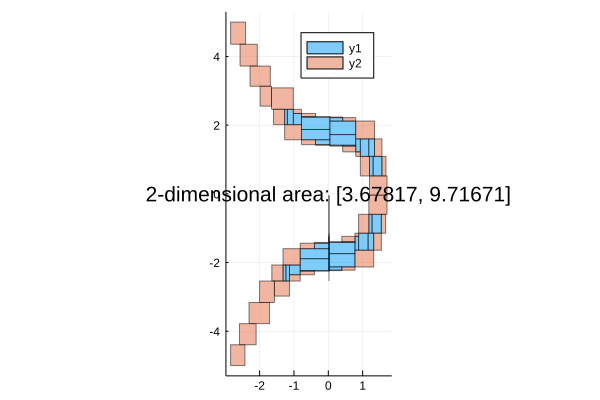

In [73]:
C = @constraint 2 <= x^3 + y^2 <= 5

X = (-5..5) × (-5..5)  # \times<TAB>

@manipulate for n in slider(0.5:0.5:8, value=0.5)
    eps = 2.0^(-n)
    
    paving = pave(C, X, eps)
    
    plot(paving.inner, aspect_ratio=:equal)
    plot!(paving.boundary, ann=(0, 0, "$(Vol(paving))"))
end

# Combine optimization with constraint propagation

- Current pull requests by Eeshan Gupta

## Plans

- Constraints involving derivatives


- Julian API with type-based dispatch (cf. `DifferentialEquations.jl`)


- JuMP interface


- Docs

- Contributions very welcome: try your hard test cases!


# Contact

- Twitter: **`@DavidPSanders`**


- http://github.com/dpsanders


- http://sistemas.fciencias.unam.mx/~dsanders


- Email: dpsanders@ciencias.unam.mx

# Finding zeros: Newton method

- Standard Newton method for finding a root:

  - Initial guess $x_0$

  - Intersect tangent line at $(x_0, f(x_0))$ with $x$-axis:


  $$x_{n+1} = x_n - \frac{f(x_n)}{f'(x_n)}$$

  - Visualization

  - Often finds a zero, but can fail to converge

## *Interval* Newton method

- Can intervals be used to **guarantee** that we have found a zero?

- Take not just tangent line, but lines with **all slopes** in interval

$$\{f'(x): x \in X\} \subseteq f'(X)$$ 

- To calculate, use **interval version of the derivative**, $f'(X)$

- Using **automatic differentiation**

## Interval Newton

- Mean value theorem: root $x^*$ satisfies

$$x^* = x - \frac{f(x)}{f'(\xi)} \quad \text{for some $\xi \in X$}$$



- Define interval Newton operator:

$$\mathcal{N}_f(X) := m(X) - \frac{f(m(X))}{f'(X)}$$


- $m(X)$: midpoint of $X$ (take as interval)


- $f(X)$: interval version of $f$  (do same operations as $f$, but on intervals)

- $f'(X)$: interval version of derivative $f'$

## Theorems:

1. $\mathcal{N}_f(X) \subseteq X \Longrightarrow$ unique root of $f$ in $X$


2. $\mathcal{N}_f(X) \cap X = \emptyset \Longrightarrow$ no root of $f$ in $X$


- Visualization: single root

- What about multiple roots?

## Visualising interval Newton

In [74]:
straight(x0, y0, x, m) = y0 + m * (x - x0)

straight (generic function with 1 method)

In [75]:
function interval_newton_full(f, X0, ymin=-10, ymax=10)

    @manipulate for n in slider(1:20, value=1), α in linspace(0, 1, 50)


        X = X0

        # draw graph of function over interval X
        xx = X.lo:0.0001:X.hi
        p = plot(xx, map(f, xx), c="blue", lw=3, xlim=(X.lo, X.hi), ylim=(ymin, ymax), legend=:false)
        hline!([0], color="magenta", lw=3, linestyle=:dash)

        Xs = [X]
        new_Xs = []

        N1 = ∅
        N2 = ∅

        for i in 1:n-1

            for X in Xs

                x0 = (1-α)*X.lo + α*X.hi # mid(X)
                deriv = ForwardDiff.derivative(f, X)

                if 0 ∈ deriv 
                    N1 = x0 - f(@interval(x0)) / @interval(deriv.lo, -0.0)
                    N2 = x0 - f(@interval(x0)) / @interval(0.0, deriv.hi)

                    N1 = N1 ∩ X
                    N2 = N2 ∩ X

                    if !(isempty(N1))
                        push!(new_Xs, N1)
                    end

                    if !(isempty(N2))
                        push!(new_Xs, N2)
                    end


                else
                    N1 = x0 - f(@interval(x0)) / deriv
                    N1 = N1 ∩ X

                    if !(isempty(N1))
                        push!(new_Xs, N1)
                    end

                end

            end

            Xs = new_Xs
            new_Xs = []

        end

        for X in Xs
            #if n > 1

                plot!([X.lo, X.hi], [0,0], c="cyan", linewidth=4, alpha=0.3)

                m = (1-α)*X.lo + α*X.hi
                scatter!([m], [0], c="green")
                scatter!([m], [f(m)], c="red")
            plot!([m, m], [0, f(m)], c="green", ls=:dash)
            #end

            x0 = (1-α)*X.lo + α*X.hi # mid(X)
            deriv = ForwardDiff.derivative(f, X)

             # draw initial point
            y0 = f(x0)
            scatter!([x0], [y0], c="red")

            # draw cone
            for m in linspace(deriv.lo, deriv.hi, 100)
                plot!([X.lo, X.hi], [ y0 + m*(x-x0) for x in [X.lo, X.hi]], color="gray", alpha=0.2)
            end

            if 0 ∈ deriv
                N1 = x0 - f(@interval(x0)) / @interval(deriv.lo, -0.0)
                N2 = x0 - f(@interval(x0)) / @interval(0.0, deriv.hi)

                N1 = N1 ∩ X
                N2 = N2 ∩ X
                
                plot!([N1.lo, N1.hi], [0,0], c="red", linewidth=4, alpha=0.8)
                plot!([N2.lo, N2.hi], [0,0], c="red", linewidth=4, alpha=0.8)

            else
                N1 = x0 - f(@interval(x0)) / deriv
                N1 = N1 ∩ X

                plot!([N1.lo, N1.hi], [0,0], c="red", linewidth=4, alpha=0.8)
            end
        end

        #text(0, 5, "$(length(Xs))")

        p

    end


    
end

interval_newton_full (generic function with 3 methods)

Interact.Slider{Int64}(43: "input-12" = 1 Int64 , "", 1, 1:20, "horizontal", true, "d", true)

Interact.Options{:SelectionSlider,Float64}(45: "input-13" = 0.4897959183673469 Float64 , "α", 0.4897959183673469, "0.4897959183673469", 25, Interact.OptionDict(DataStructures.OrderedDict("0.0"=>0.0,"0.02040816326530612"=>0.0204082,"0.04081632653061224"=>0.0408163,"0.061224489795918366"=>0.0612245,"0.08163265306122448"=>0.0816327,"0.10204081632653061"=>0.102041,"0.12244897959183673"=>0.122449,"0.14285714285714285"=>0.142857,"0.16326530612244897"=>0.163265,"0.1836734693877551"=>0.183673…), Dict(0.122449=>"0.12244897959183673",0.795918=>"0.7959183673469388",0.591837=>"0.5918367346938775",0.693878=>"0.6938775510204082",0.959184=>"0.9591836734693877",0.55102=>"0.5510204081632653",0.387755=>"0.3877551020408163",0.367347=>"0.3673469387755102",0.612245=>"0.6122448979591837",0.44898=>"0.4489795918367347"…)), Any[], Any[], true, "horizontal", true)

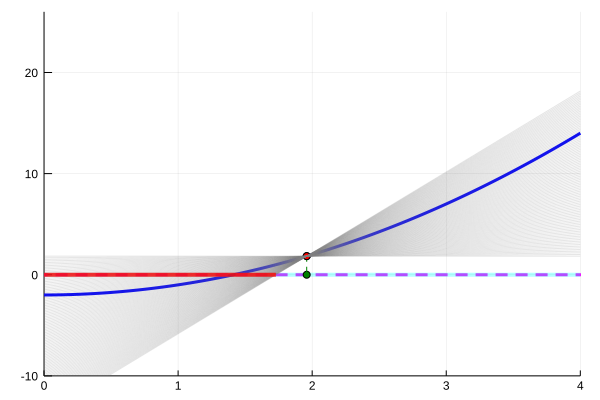

In [76]:
xx = -1:0.01:10
f(x) = x^2 - 2
x0 = 8

interval_newton_full(x->f(x), 0..4, -10, 26)

Interact.Slider{Int64}(49: "input-14" = 1 Int64 , "", 1, 1:20, "horizontal", true, "d", true)

Interact.Options{:SelectionSlider,Float64}(51: "input-15" = 0.4897959183673469 Float64 , "α", 0.4897959183673469, "0.4897959183673469", 25, Interact.OptionDict(DataStructures.OrderedDict("0.0"=>0.0,"0.02040816326530612"=>0.0204082,"0.04081632653061224"=>0.0408163,"0.061224489795918366"=>0.0612245,"0.08163265306122448"=>0.0816327,"0.10204081632653061"=>0.102041,"0.12244897959183673"=>0.122449,"0.14285714285714285"=>0.142857,"0.16326530612244897"=>0.163265,"0.1836734693877551"=>0.183673…), Dict(0.122449=>"0.12244897959183673",0.795918=>"0.7959183673469388",0.591837=>"0.5918367346938775",0.693878=>"0.6938775510204082",0.959184=>"0.9591836734693877",0.55102=>"0.5510204081632653",0.387755=>"0.3877551020408163",0.367347=>"0.3673469387755102",0.612245=>"0.6122448979591837",0.44898=>"0.4489795918367347"…)), Any[], Any[], true, "horizontal", true)

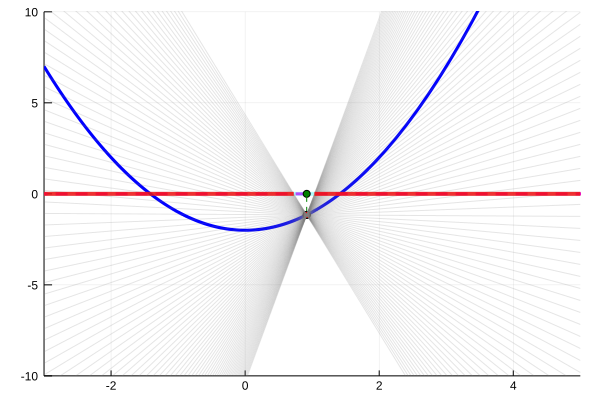

In [77]:
interval_newton_full(x->x^2 - 2, -3..5, -10, 10)

## Linear constrained optimization problem

Interact.Options{:SelectionSlider,Float64}(55: "input-16" = 0.0 Float64 , "a", 0.0, "0.0", 201, Interact.OptionDict(DataStructures.OrderedDict("-2.0"=>-2.0,"-1.99"=>-1.99,"-1.98"=>-1.98,"-1.97"=>-1.97,"-1.96"=>-1.96,"-1.95"=>-1.95,"-1.94"=>-1.94,"-1.93"=>-1.93,"-1.92"=>-1.92,"-1.91"=>-1.91…), Dict(-0.92=>"-0.92",1.2=>"1.2",1.68=>"1.68",-0.22=>"-0.22",-1.78=>"-1.78",1.19=>"1.19",-1.23=>"-1.23",0.22=>"0.22",-1.16=>"-1.16",0.2=>"0.2"…)), Any[], Any[], true, "horizontal", true)

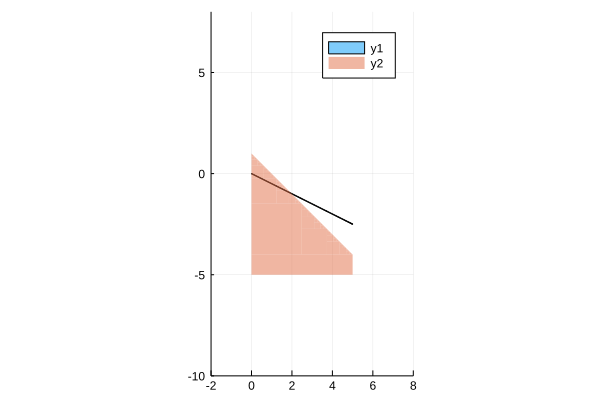

In [78]:
gr()

@manipulate for a in -2:0.01:2
    C1 = @constraint x + 2y - $a == 0
    X = IntervalBox(0..5, -5..1)
    paving1 = pave(C1, X, 0.01)
    
    C2 = @constraint x + y <= 1
    paving2 = pave(C2, X, 0.01)
    
    plot(paving1.boundary, aspect_ratio=1)
    plot!(paving2.inner, lw=0)
    
    xlims!(-2, 8)
    ylims!(-10, 8)
    
end
    
    